<a href="https://colab.research.google.com/github/abinayaa123/ME592/blob/main/Final%20Project%20/ME592_ESHM_FinalProject.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Project Description

Data sourced from:
https://ti.arc.nasa.gov/tech/dash/groups/pcoe/prognostic-data-repository/#turbofan 

Training and test data is taken from source. Data is from turbofan simulation.

Each training or test data set (four are provided for each) contains various trajectories (simulations) each of which is run for multiple cycles. The remaining useful life ("RUL") metric is the number of cycles remaining until failure.

Training data was generated by running simulation to "failure", so the RUL known. Test data was generated by running the simulation to some arbitrary number of cycles (before failure), so RUL is unknown given just the test set. However, the "real" RUL is provided for the Test data set.

Goal is to accurately predict the remaining useful life ("RUL") for the Test set by training with the Train set. Model must be trained on and will need to predict RUL for each trajectory individually.


# Data Import and Augmentation

Code assumes you have the raw data files stored on your google drive at "drive/MyDrive/ME592/Final/"

In [ ]:
#Import libraries
import numpy as np
import pandas as pd
from math import sqrt
from numpy import concatenate
from matplotlib import pyplot as plt
from tensorflow import keras
# Highly recommended for time series data
from pandas import read_csv
from pandas import DataFrame
from pandas import concat
# Processing and metrics
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
# keras --2019--> tf.keras
import tensorflow as tf
from tensorflow.keras import datasets, layers, models
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout, Masking, TimeDistributed
from google.colab import drive
drive.mount('/content/drive')

# seed random generators for repeatable results
import random
seed = 42
random.seed(seed)
np.random.seed(seed)
tf.random.set_seed(seed)

Mounted at /content/drive


In [ ]:
#Create dataframes
df_train_1=pd.read_table('drive/MyDrive/ME592/Final/train_FD001.txt',delimiter='\s+',header=None)
df_test_1=pd.read_table('drive/MyDrive/ME592/Final/test_FD001.txt',delimiter='\s+',header=None)
df_test_rul_1=pd.read_table('drive/MyDrive/ME592/Final/RUL_FD001.txt',delimiter='\s+',header=None)

df_train_2=pd.read_table('drive/MyDrive/ME592/Final/train_FD002.txt',delimiter='\s+',header=None)
df_test_2=pd.read_table('drive/MyDrive/ME592/Final/test_FD002.txt',delimiter='\s+',header=None)
df_test_rul_2=pd.read_table('drive/MyDrive/ME592/Final/RUL_FD002.txt',delimiter='\s+',header=None)

df_train_3=pd.read_table('drive/MyDrive/ME592/Final/train_FD003.txt',delimiter='\s+',header=None)
df_test_3=pd.read_table('drive/MyDrive/ME592/Final/test_FD003.txt',delimiter='\s+',header=None)
df_test_rul_3=pd.read_table('drive/MyDrive/ME592/Final/RUL_FD003.txt',delimiter='\s+',header=None)

df_train_4=pd.read_table('drive/MyDrive/ME592/Final/train_FD004.txt',delimiter='\s+',header=None)
df_test_4=pd.read_table('drive/MyDrive/ME592/Final/test_FD004.txt',delimiter='\s+',header=None)
df_test_rul_4=pd.read_table('drive/MyDrive/ME592/Final/RUL_FD004.txt',delimiter='\s+',header=None)

In [ ]:
# Add Headers
traj_cycle=['Trajectory','CycleNumber']
settings=['Setting{}'.format(i+1) for i in range(0,3)]
sensors=['Sensor{}'.format(i+1) for i in range(0,21)]
variables = settings + sensors
header=traj_cycle+settings+sensors
df_train_1.columns=header
df_test_1.columns=header
df_train_2.columns=header
df_test_2.columns=header
df_train_3.columns=header
df_test_3.columns=header
df_train_4.columns=header
df_test_4.columns=header

In [ ]:
# Create cycle counts for each trajectory in training set 1
cycle_counts=df_train_1.groupby("Trajectory").max()
# Create full RUL array
RUL=[]
for k in np.arange(0,len(cycle_counts)):
  temparr=np.arange(cycle_counts.iloc[k,0]-1,-1,-1)
  RUL=np.concatenate((RUL,temparr))
RUL=RUL.astype(int)
#Add RUL array to df
df_train_1['RUL']=RUL

# Find the RUL in each test trajectory (slower method)
df_test_1['RUL'] = ''
for  k in range(0,len(df_test_1)):
  trajectory = df_test_1.iloc[k]['Trajectory']
  cycle = df_test_1.iloc[k]['CycleNumber']
  cycle_max = df_test_1[df_test_1['Trajectory'] == trajectory]['CycleNumber'].max()
  df_test_1.at[k, 'RUL'] = cycle_max - cycle + df_test_rul_1.values[trajectory-1]

In [ ]:
# Create cycle counts for each trajectory in training set 2
cycle_counts=df_train_2.groupby("Trajectory").max()
# Create full RUL array
RUL=[]
for k in np.arange(0,len(cycle_counts)):
  temparr=np.arange(cycle_counts.iloc[k,0]-1,-1,-1)
  RUL=np.concatenate((RUL,temparr))
RUL=RUL.astype(int)
#Add RUL array to df
df_train_2['RUL']=RUL

# Find the RUL in each test trajectory (slower method)
df_test_2['RUL'] = ''
for  k in range(0,len(df_test_2)):
  trajectory = df_test_2.iloc[k]['Trajectory']
  cycle = df_test_2.iloc[k]['CycleNumber']
  cycle_max = df_test_2[df_test_2['Trajectory'] == trajectory]['CycleNumber'].max()
  df_test_2.at[k, 'RUL'] = cycle_max - cycle + df_test_rul_2.values[trajectory-1]

In [ ]:
# Create cycle counts for each trajectory in training set 3
cycle_counts=df_train_3.groupby("Trajectory").max()
# Create full RUL array
RUL=[]
for k in np.arange(0,len(cycle_counts)):
  temparr=np.arange(cycle_counts.iloc[k,0]-1,-1,-1)
  RUL=np.concatenate((RUL,temparr))
RUL=RUL.astype(int)
#Add RUL array to df
df_train_3['RUL']=RUL

# Find the RUL in each test trajectory (slower method)
df_test_3['RUL'] = ''
for  k in range(0,len(df_test_3)):
  trajectory = df_test_3.iloc[k]['Trajectory']
  cycle = df_test_3.iloc[k]['CycleNumber']
  cycle_max = df_test_3[df_test_3['Trajectory'] == trajectory]['CycleNumber'].max()
  df_test_3.at[k, 'RUL'] = cycle_max - cycle + df_test_rul_3.values[trajectory-1]

In [ ]:
# Create cycle counts for each trajectory in training set 4
cycle_counts=df_train_4.groupby("Trajectory").max()
# Create full RUL array
RUL=[]
for k in np.arange(0,len(cycle_counts)):
  temparr=np.arange(cycle_counts.iloc[k,0]-1,-1,-1)
  RUL=np.concatenate((RUL,temparr))
RUL=RUL.astype(int)
#Add RUL array to df
df_train_4['RUL']=RUL

# Find the RUL in each test trajectory (slower method)
df_test_4['RUL'] = ''
for  k in range(0,len(df_test_4)):
  trajectory = df_test_4.iloc[k]['Trajectory']
  cycle = df_test_4.iloc[k]['CycleNumber']
  cycle_max = df_test_4[df_test_4['Trajectory'] == trajectory]['CycleNumber'].max()
  df_test_4.at[k, 'RUL'] = cycle_max - cycle + df_test_rul_4.values[trajectory-1]

In [ ]:
#Check df train 1
df_train_1[df_train_1['Trajectory'] == 1]

,Trajectory,CycleNumber,Setting1,Setting2,Setting3,Sensor1,Sensor2,Sensor3,Sensor4,Sensor5,...,Sensor13,Sensor14,Sensor15,Sensor16,Sensor17,Sensor18,Sensor19,Sensor20,Sensor21,RUL
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,191
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,190
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,189
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,188
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
187,1,188,-0.0067,0.0003,100.0,518.67,643.75,1602.38,1422.78,14.62,...,2388.23,8117.69,8.5207,0.03,396,2388,100.0,38.51,22.9588,4
188,1,189,-0.0006,0.0002,100.0,518.67,644.18,1596.17,1428.01,14.62,...,2388.33,8117.51,8.5183,0.03,395,2388,100.0,38.48,23.1127,3
189,1,190,-0.0027,0.0001,100.0,518.67,643.64,1599.22,1425.95,14.62,...,2388.35,8112.58,8.5223,0.03,398,2388,100.0,38.49,23.0675,2
190,1,191,-0.0000,-0.0004,100.0,518.67,643.34,1602.36,1425.77,14.62,...,2388.30,8114.61,8.5174,0.03,394,2388,100.0,38.45,23.1295,1


In [ ]:
#Check df train 4
df_train_4

,Trajectory,CycleNumber,Setting1,Setting2,Setting3,Sensor1,Sensor2,Sensor3,Sensor4,Sensor5,...,Sensor13,Sensor14,Sensor15,Sensor16,Sensor17,Sensor18,Sensor19,Sensor20,Sensor21,RUL
0,1,1,42.0049,0.8400,100.0,445.00,549.68,1343.43,1112.93,3.91,...,2387.99,8074.83,9.3335,0.02,330,2212,100.00,10.62,6.3670,320
1,1,2,20.0020,0.7002,100.0,491.19,606.07,1477.61,1237.50,9.35,...,2387.73,8046.13,9.1913,0.02,361,2324,100.00,24.37,14.6552,319
2,1,3,42.0038,0.8409,100.0,445.00,548.95,1343.12,1117.05,3.91,...,2387.97,8066.62,9.4007,0.02,329,2212,100.00,10.48,6.4213,318
3,1,4,42.0000,0.8400,100.0,445.00,548.70,1341.24,1118.03,3.91,...,2388.02,8076.05,9.3369,0.02,328,2212,100.00,10.54,6.4176,317
4,1,5,25.0063,0.6207,60.0,462.54,536.10,1255.23,1033.59,7.05,...,2028.08,7865.80,10.8366,0.02,305,1915,84.93,14.03,8.6754,316
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61244,249,251,9.9998,0.2500,100.0,489.05,605.33,1516.36,1315.28,10.52,...,2388.73,8185.69,8.4541,0.03,372,2319,100.00,29.11,17.5234,4
61245,249,252,0.0028,0.0015,100.0,518.67,643.42,1598.92,1426.77,14.62,...,2388.46,8185.47,8.2221,0.03,396,2388,100.00,39.38,23.7151,3
61246,249,253,0.0029,0.0000,100.0,518.67,643.68,1607.72,1430.56,14.62,...,2388.48,8193.94,8.2525,0.03,395,2388,100.00,39.78,23.8270,2
61247,249,254,35.0046,0.8400,100.0,449.44,555.77,1381.29,1148.18,5.48,...,2388.83,8125.64,9.0515,0.02,337,2223,100.00,15.26,9.0774,1


In [ ]:
df_test_1[df_test_1['Trajectory']==1]

,Trajectory,CycleNumber,Setting1,Setting2,Setting3,Sensor1,Sensor2,Sensor3,Sensor4,Sensor5,...,Sensor13,Sensor14,Sensor15,Sensor16,Sensor17,Sensor18,Sensor19,Sensor20,Sensor21,RUL
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,...,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735,[142]
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,...,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916,[141]
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,...,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166,[140]
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,...,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737,[139]
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,...,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130,[138]
5,1,6,0.0012,0.0003,100.0,518.67,642.11,1579.12,1395.13,14.62,...,2388.08,8127.46,8.4238,0.03,392,2388,100.0,38.91,23.3467,[137]
6,1,7,-0.0000,0.0002,100.0,518.67,642.11,1583.34,1404.84,14.62,...,2388.06,8134.97,8.3914,0.03,391,2388,100.0,38.85,23.3952,[136]
7,1,8,0.0006,-0.0000,100.0,518.67,642.54,1580.89,1400.89,14.62,...,2388.06,8125.93,8.4213,0.03,393,2388,100.0,39.05,23.3224,[135]
8,1,9,-0.0036,0.0000,100.0,518.67,641.88,1593.29,1412.28,14.62,...,2388.05,8134.15,8.4353,0.03,391,2388,100.0,39.10,23.4521,[134]
9,1,10,-0.0025,-0.0001,100.0,518.67,642.07,1585.25,1398.64,14.62,...,2388.06,8134.08,8.4093,0.03,391,2388,100.0,38.87,23.3820,[133]


Training data is stored in four dataframes (df_train_1 through df_train_4), each containing multiple trajectories, each trajectory containing all provided data (cycle number, settings 1-3, sensors 1-21) along with the manually created Remaining Useful Life ("RUL") column that is the primary prediction objective.

Test data is similarly stored in four dataframes, same headers as training set, except no RUL column.

Test data RUL is stored as a dataframe with one column, each row is the remaining useful life in cycles at the end of the Test data for each trajectory.

Once model is trained, evaluate by predicting the test data sets (df_test_1 through 4) and comparing RUL prediction for each trajectory to known RUL in df_test_rul_1 through _4

# Data Preparation (preprocessing, structuring for models)

## Data Visualization and Investigation

In [ ]:
# With such a complicated dataset, the first task is to evaluate the different
# sensors in order to identify potential key variables or relationships

In [ ]:
# First method is to visually examine the data by plotting different settings 
# and sensors against the RUL

# number of trajectories
traj_train_max_4 = df_train_4['Trajectory'].max()
traj_test_max_4 = df_test_4['Trajectory'].max()
traj_train_max_3 = df_train_3['Trajectory'].max()
traj_test_max_3 = df_test_3['Trajectory'].max()
traj_train_max_2 = df_train_2['Trajectory'].max()
traj_test_max_2 = df_test_2['Trajectory'].max()
traj_train_max_1 = df_train_1['Trajectory'].max()
traj_test_max_1 = df_test_1['Trajectory'].max()

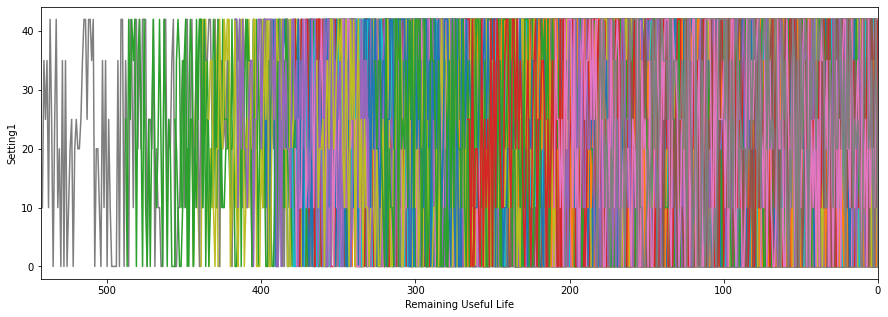

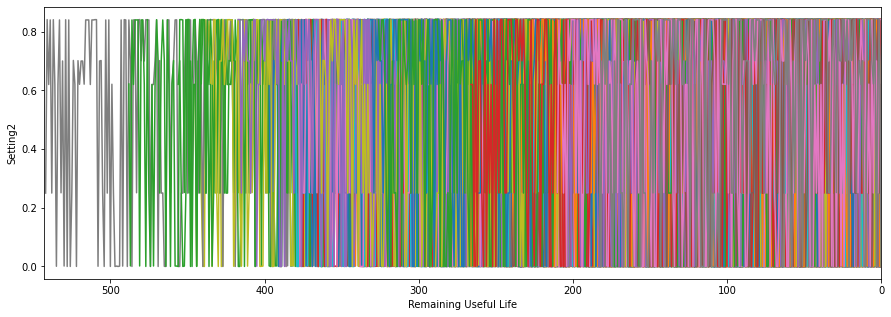

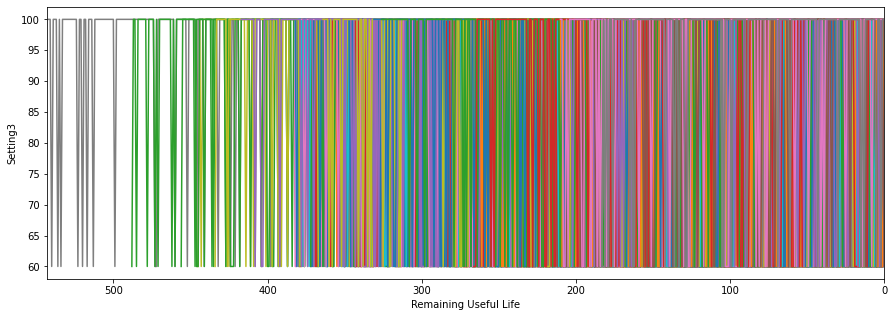

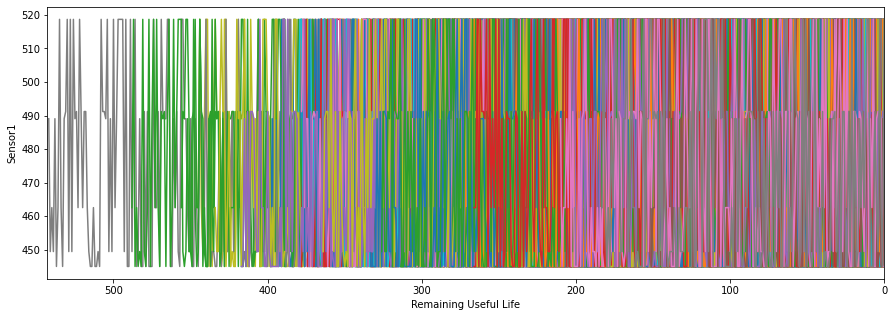

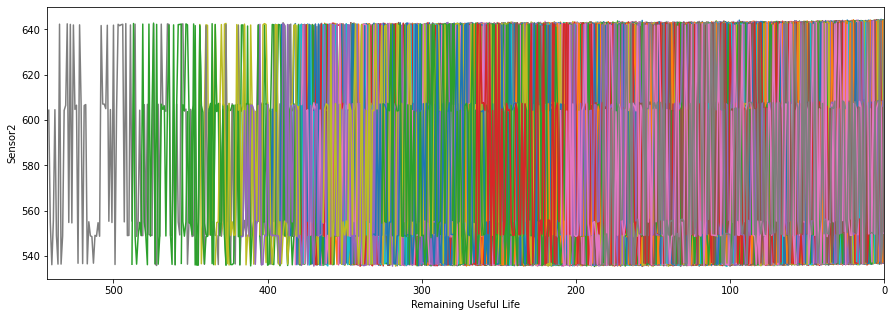

...

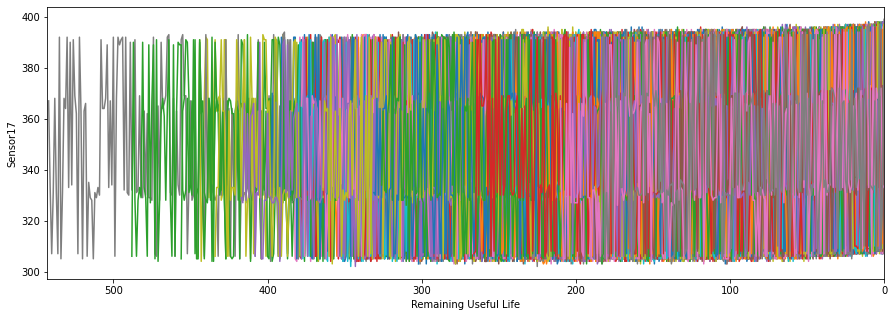

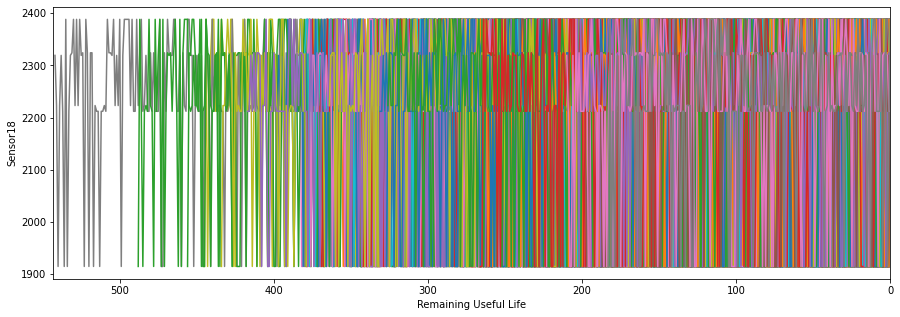

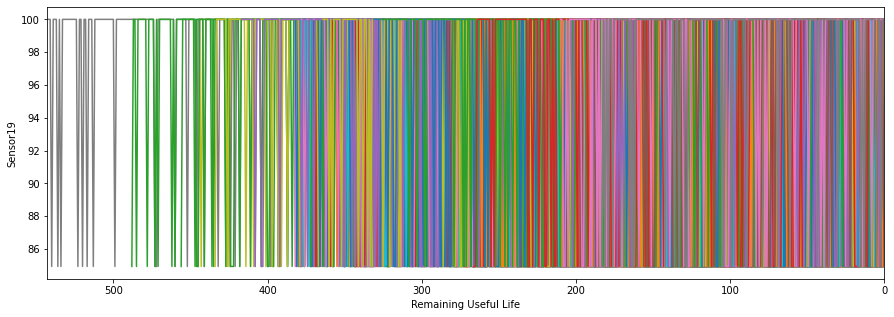

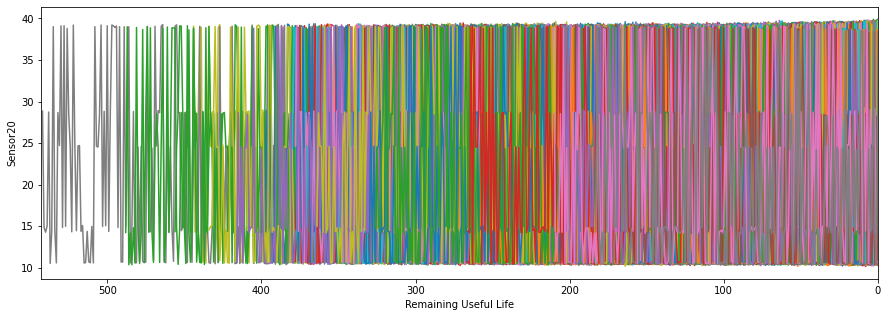

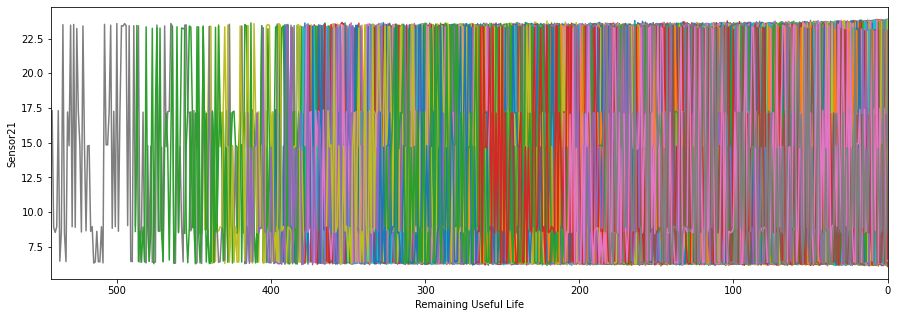

In [ ]:
# plot all settings and sensors for each training trajectory
# Only look at FD004 as example
for i in range(0,len(variables)):
  plt.figure(figsize=(15,5))
  for k in range(1,traj_train_max_4):
    traj_k = df_train_4[df_train_4['Trajectory'] == k]
    sensor = traj_k[variables[i]]
    RUL_temp = traj_k['RUL']
    plt.plot(RUL_temp, sensor)
  plt.xlim(df_train_4['CycleNumber'].max(), 0)  # reverse the x-axis so RUL counts down to zero
  plt.ylabel(variables[i])
  plt.xlabel('Remaining Useful Life')
  plt.show()

## Preprocessing Method 1: Standard Scaler

In [ ]:
# data is noisy and not scaled
# use built-in scaling thorugh sklearn.preprocessing.StandardScaler
# The standard score of a sample x is calculated as:
#   z = (x - u) / s
# where u is the mean of the training samples or zero if with_mean=False, and s 
# is the standard deviation of the training samples or one if with_std=False.
# https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html

# GitHub user kpeters standardizes each trajectory individually.
# It is hypothesized that this accounts for each trajectory having 
# small differences in motor and initial wear. 

df_train_1_prep = df_train_1.copy()
df_test_1_prep = df_test_1.copy()
df_train_2_prep = df_train_2.copy()
df_test_2_prep = df_test_2.copy()
df_train_3_prep = df_train_3.copy()
df_test_3_prep = df_test_3.copy()
df_train_4_prep = df_train_4.copy()
df_test_4_prep = df_test_4.copy()

scaler = StandardScaler()

# Standardize for each trajectory
for k in range(1,traj_train_max_4+1):
  scaler.fit(df_train_4.loc[df_train_4['Trajectory'] == k, variables])
  df_train_4_prep.loc[df_train_4_prep['Trajectory'] == k, variables] = scaler.transform(df_train_4.loc[df_train_4['Trajectory'] == k, variables])

for k in range(1,traj_test_max_4+1):
  scaler.fit(df_test_4.loc[df_test_4['Trajectory'] == k, variables])
  df_test_4_prep.loc[df_test_4_prep['Trajectory'] == k, variables] = scaler.transform(df_test_4.loc[df_test_4['Trajectory'] == k, variables])

for k in range(1,traj_train_max_3+1):
  scaler.fit(df_train_3.loc[df_train_3['Trajectory'] == k, variables])
  df_train_3_prep.loc[df_train_3_prep['Trajectory'] == k, variables] = scaler.transform(df_train_3.loc[df_train_3['Trajectory'] == k, variables])

for k in range(1,traj_test_max_3+1):
  scaler.fit(df_test_3.loc[df_test_3['Trajectory'] == k, variables])
  df_test_3_prep.loc[df_test_3_prep['Trajectory'] == k, variables] = scaler.transform(df_test_3.loc[df_test_3['Trajectory'] == k, variables])

for k in range(1,traj_train_max_2+1):
  scaler.fit(df_train_2.loc[df_train_2['Trajectory'] == k, variables])
  df_train_2_prep.loc[df_train_2_prep['Trajectory'] == k, variables] = scaler.transform(df_train_2.loc[df_train_2['Trajectory'] == k, variables])

for k in range(1,traj_test_max_2+1):
  scaler.fit(df_test_2.loc[df_test_2['Trajectory'] == k, variables])
  df_test_2_prep.loc[df_test_2_prep['Trajectory'] == k, variables] = scaler.transform(df_test_2.loc[df_test_2['Trajectory'] == k, variables])

for k in range(1,traj_train_max_1+1):
  scaler.fit(df_train_1.loc[df_train_1['Trajectory'] == k, variables])
  df_train_1_prep.loc[df_train_1_prep['Trajectory'] == k, variables] = scaler.transform(df_train_1.loc[df_train_1['Trajectory'] == k, variables])

for k in range(1,traj_test_max_1+1):
  scaler.fit(df_test_1.loc[df_test_1['Trajectory'] == k, variables])
  df_test_1_prep.loc[df_test_1_prep['Trajectory'] == k, variables] = scaler.transform(df_test_1.loc[df_test_1['Trajectory'] == k, variables])


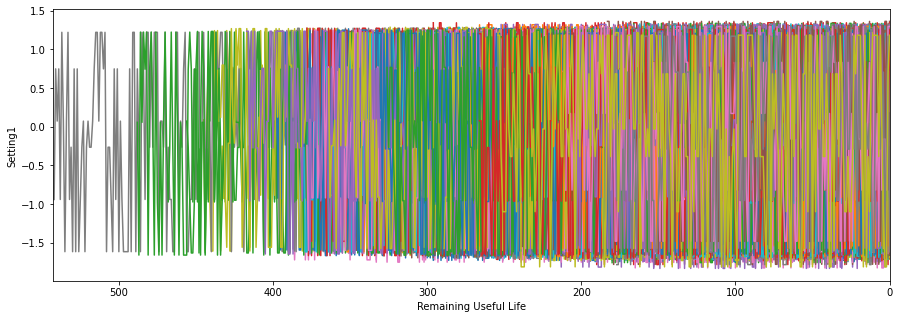

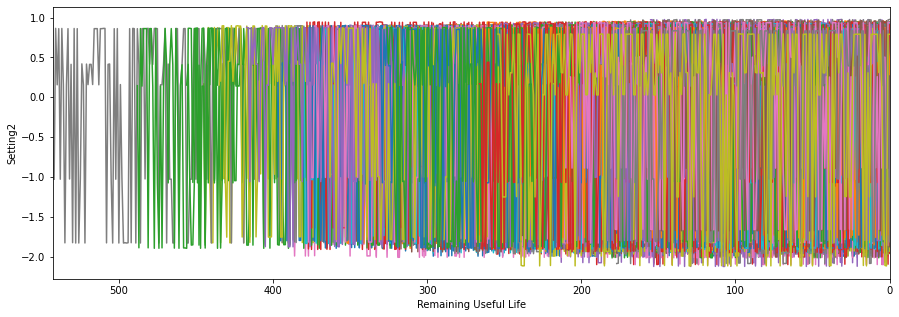

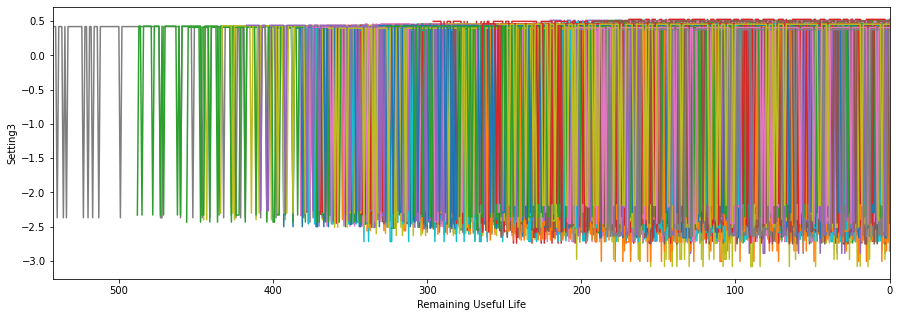

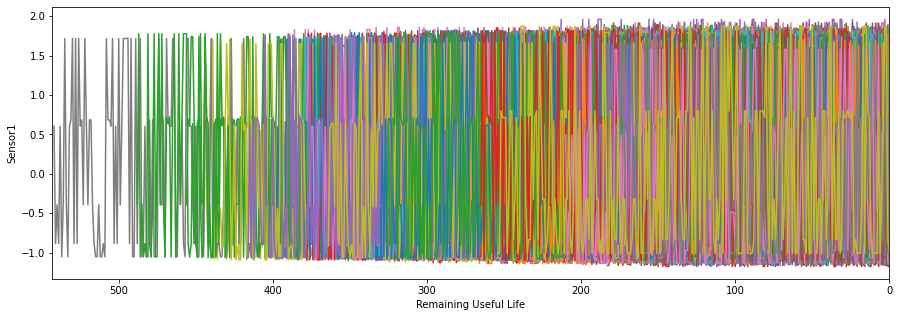

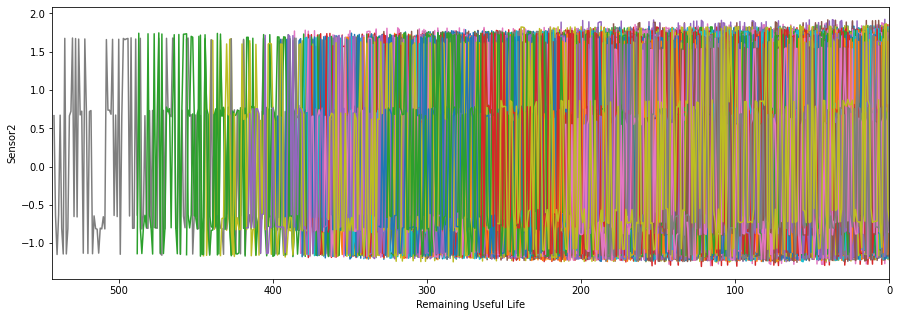

...

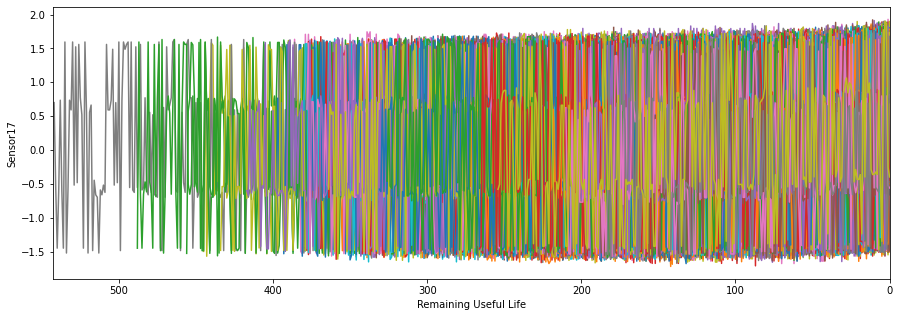

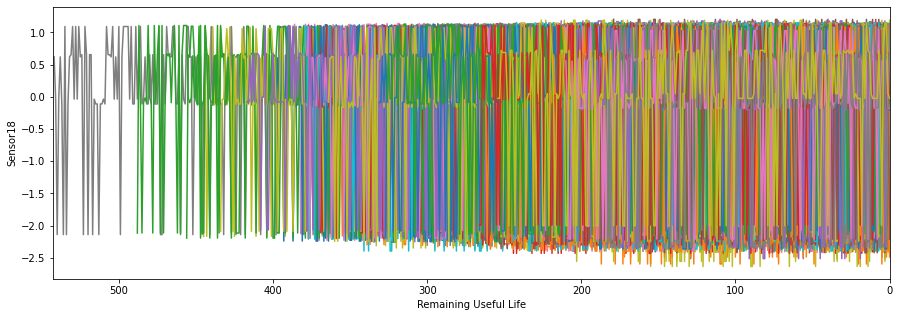

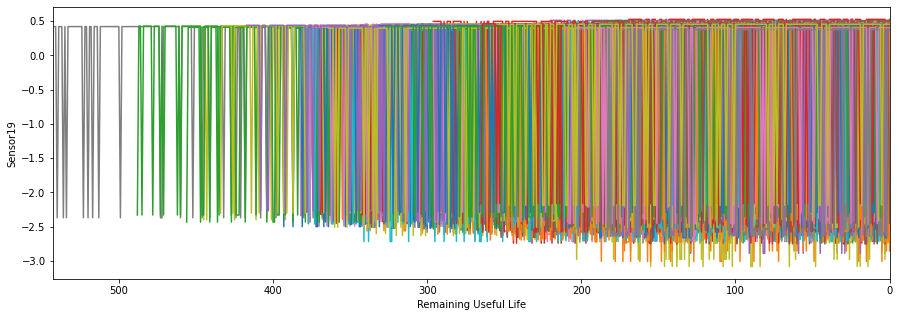

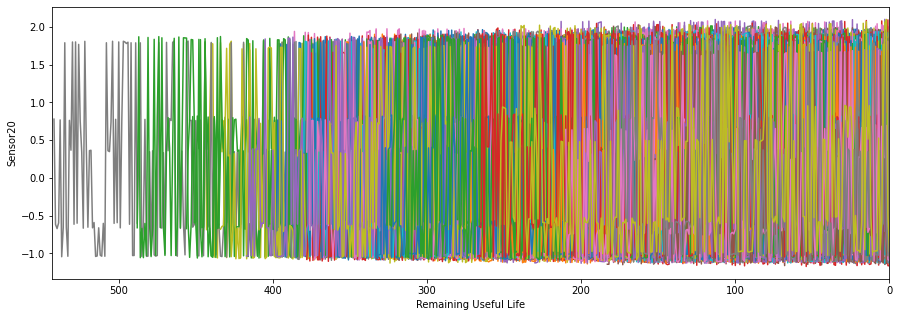

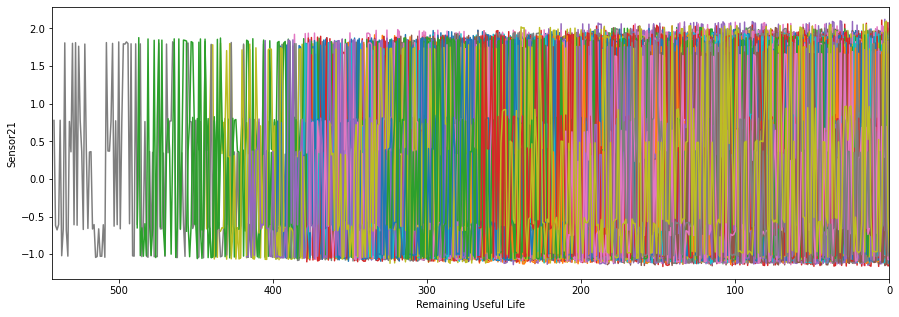

In [ ]:
# plot all settings and sensors for each training trajectory
# Again, only look at FD004 as example
for i in range(0,len(variables)):
  plt.figure(figsize=(15,5))

  for k in range(1,traj_train_max_4+1):
    traj_k = df_train_4_prep[df_train_4_prep['Trajectory'] == k]
    sensor = traj_k[variables[i]]
    RUL_temp = traj_k['RUL']
    plt.plot(RUL_temp, sensor)
  plt.xlim(df_train_4_prep['CycleNumber'].max(), 0)  # reverse the x-axis so RUL counts down to zero
  plt.ylabel(variables[i])
  plt.xlabel('Remaining Useful Life')
  plt.show()

## Preprocessing Method 2: Rolling Average

In [ ]:
# prepare data
df_train_1_smooth = df_train_1_prep.copy()
df_test_1_smooth = df_test_1_prep.copy()

df_train_2_smooth = df_train_2_prep.copy()
df_test_2_smooth = df_test_2_prep.copy()

df_train_3_smooth = df_train_3_prep.copy()
df_test_3_smooth = df_test_3_prep.copy()

df_train_4_smooth = df_train_4_prep.copy()
df_test_4_smooth = df_test_4_prep.copy()

In [ ]:
# Standardize for each trajectory
for k in range(1,traj_train_max_1+1):
  df_train_1_smooth.loc[df_train_1_smooth['Trajectory'] == k, variables] = df_train_1_smooth.loc[df_train_1_smooth['Trajectory'] == k, variables].rolling(10).mean()

for k in range(1,traj_train_max_1+1):
  df_test_1_smooth.loc[df_test_1_smooth['Trajectory'] == k, variables] = df_test_1_smooth.loc[df_test_1_smooth['Trajectory'] == k, variables].rolling(10).mean()

for k in range(1,traj_train_max_2+1):
  df_train_2_smooth.loc[df_train_2_smooth['Trajectory'] == k, variables] = df_train_2_smooth.loc[df_train_2_smooth['Trajectory'] == k, variables].rolling(10).mean()

for k in range(1,traj_train_max_2+1):
  df_test_2_smooth.loc[df_test_2_smooth['Trajectory'] == k, variables] = df_test_2_smooth.loc[df_test_2_smooth['Trajectory'] == k, variables].rolling(10).mean()

for k in range(1,traj_train_max_3+1):
  df_train_3_smooth.loc[df_train_3_smooth['Trajectory'] == k, variables] = df_train_3_smooth.loc[df_train_3_smooth['Trajectory'] == k, variables].rolling(10).mean()

for k in range(1,traj_train_max_3+1):
  df_test_3_smooth.loc[df_test_3_smooth['Trajectory'] == k, variables] = df_test_3_smooth.loc[df_test_3_smooth['Trajectory'] == k, variables].rolling(10).mean()

for k in range(1,traj_train_max_4+1):
  df_train_4_smooth.loc[df_train_4_smooth['Trajectory'] == k, variables] = df_train_4_smooth.loc[df_train_4_smooth['Trajectory'] == k, variables].rolling(10).mean()

for k in range(1,traj_train_max_4+1):
  df_test_4_smooth.loc[df_test_4_smooth['Trajectory'] == k, variables] = df_test_4_smooth.loc[df_test_4_smooth['Trajectory'] == k, variables].rolling(10).mean()

In [ ]:
# drop NA rows - this takes away some data but is necessary
df_train_1_smooth = df_train_1_smooth.dropna()
df_test_1_smooth = df_test_1_smooth.dropna()

df_train_2_smooth = df_train_2_smooth.dropna()
df_test_2_smooth = df_test_2_smooth.dropna()

df_train_3_smooth = df_train_3_smooth.dropna()
df_test_3_smooth = df_test_3_smooth.dropna()

df_train_4_smooth = df_train_4_smooth.dropna()
df_test_4_smooth = df_test_4_smooth.dropna()

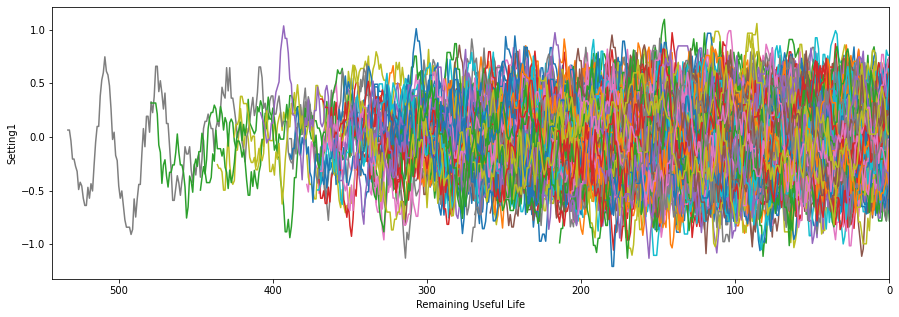

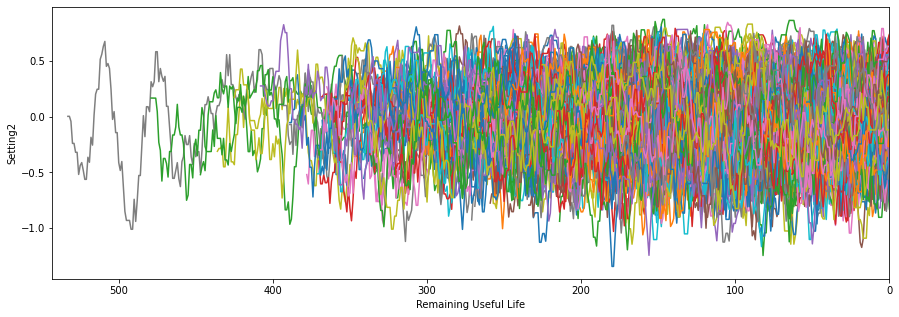

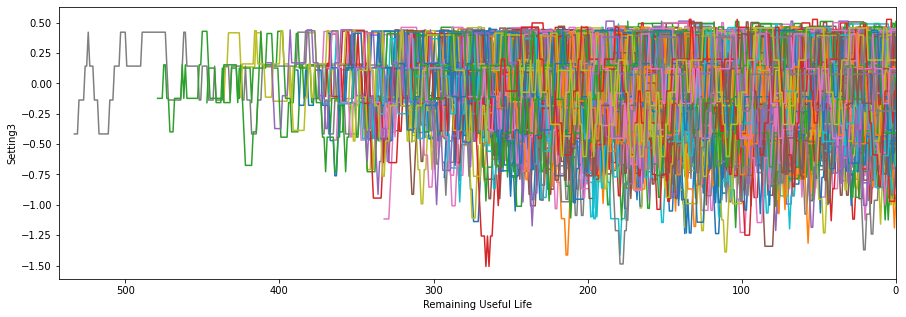

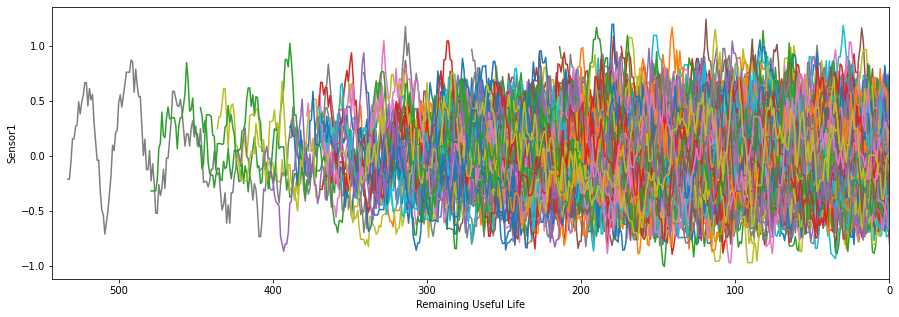

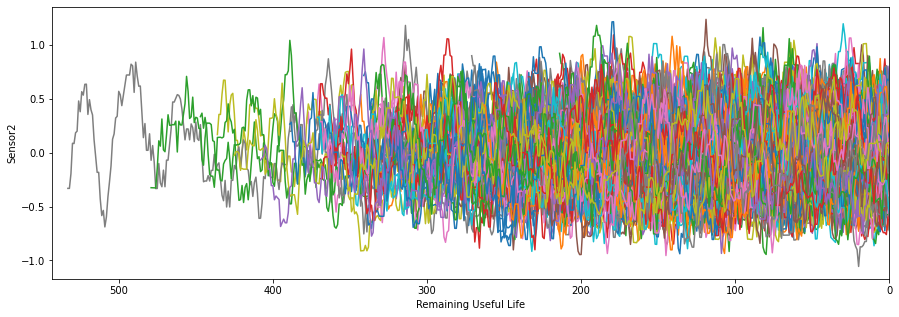

...

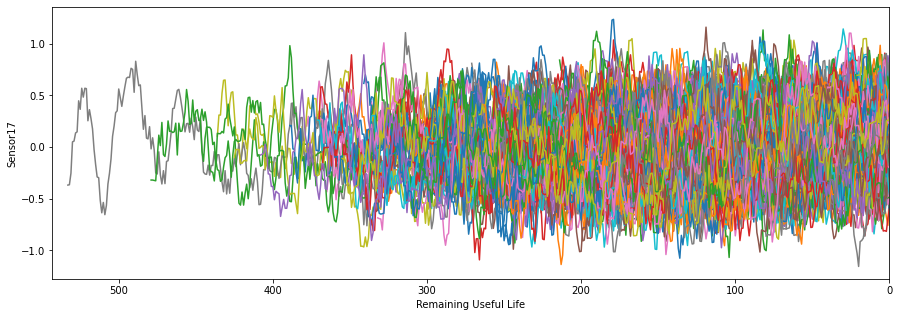

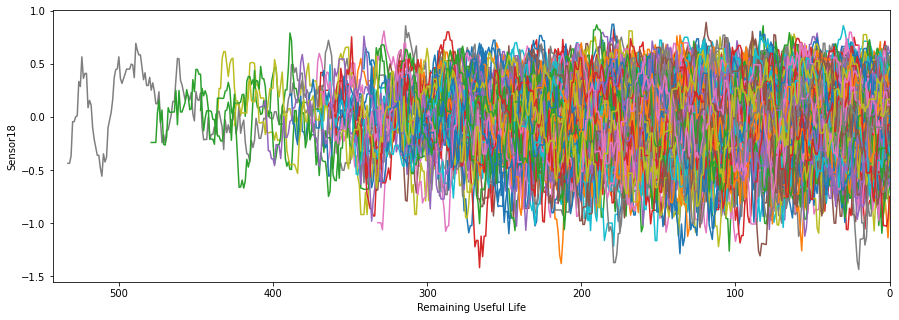

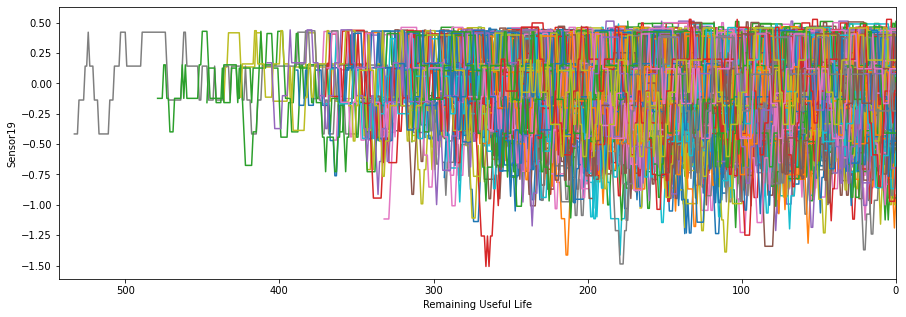

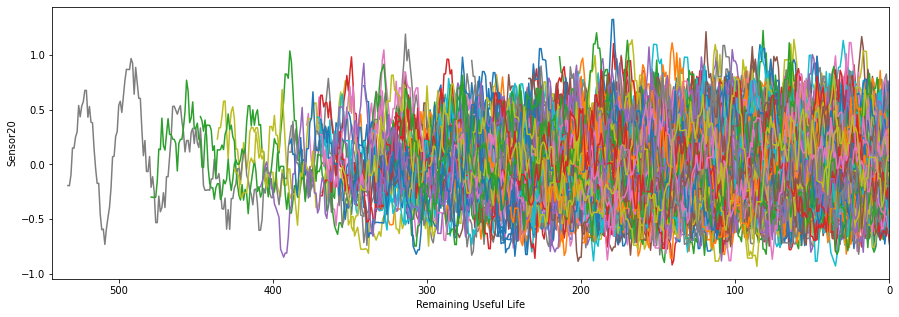

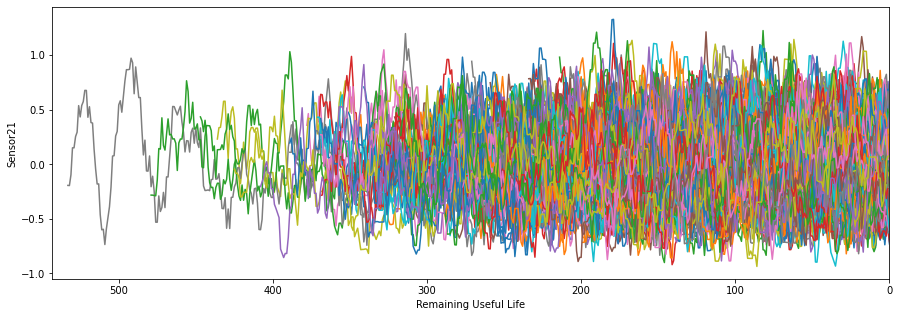

In [ ]:
# plot all settings and sensors for each training trajectory
for i in range(0,len(variables)):
  plt.figure(figsize=(15,5))
  for k in range(1,traj_train_max_4+1):
    traj_k = df_train_4_smooth[df_train_4_smooth['Trajectory'] == k]
    sensor = traj_k[variables[i]]
    RUL_temp = traj_k['RUL']
    plt.plot(RUL_temp, sensor)
  plt.xlim(df_train_4_smooth['CycleNumber'].max(), 0)  # reverse the x-axis so RUL counts down to zero
  plt.ylabel(variables[i])
  plt.xlabel('Remaining Useful Life')
  plt.show()

## Preprocessing Method 3: Identify Key Sensors

In [ ]:
# The third method of preprocessing is to identify key sensors, then remove the 
# remainder to evaluate if performance is impacted. Based on the initial data
# visualization and investigation, sensors 1, 5, 6, 8, 13, 16, 18, and 19 do
# not exhibit any change over the course of each trajectory.

# This leaves the key sensors as 2, 3, 4, 7, 9, 10, 11, 12, 14, 15, 17, 20, and
# 21


In [ ]:
df_train_1_key = df_train_1_prep.copy()
df_test_1_key = df_test_1_prep.copy()
df_train_2_key = df_train_2_prep.copy()
df_test_2_key = df_test_2_prep.copy()
df_train_3_key = df_train_3_prep.copy()
df_test_3_key = df_test_3_prep.copy()
df_train_4_key = df_train_4_prep.copy()
df_test_4_key = df_test_4_prep.copy()

df_train_1_key = df_train_1_key.drop(['Sensor1','Sensor5','Sensor6','Sensor8',
                                      'Sensor13','Sensor16','Sensor18','Sensor19',], axis=1)
df_test_1_key = df_test_1_key.drop(['Sensor1','Sensor5','Sensor6','Sensor8',
                                      'Sensor13','Sensor16','Sensor18','Sensor19',], axis=1)
df_train_2_key = df_train_2_key.drop(['Sensor1','Sensor5','Sensor6','Sensor8',
                                      'Sensor13','Sensor16','Sensor18','Sensor19',], axis=1)
df_test_2_key = df_test_2_key.drop(['Sensor1','Sensor5','Sensor6','Sensor8',
                                      'Sensor13','Sensor16','Sensor18','Sensor19',], axis=1)
df_train_3_key = df_train_3_key.drop(['Sensor1','Sensor5','Sensor6','Sensor8',
                                      'Sensor13','Sensor16','Sensor18','Sensor19',], axis=1)
df_test_3_key = df_test_3_key.drop(['Sensor1','Sensor5','Sensor6','Sensor8',
                                      'Sensor13','Sensor16','Sensor18','Sensor19',], axis=1)
df_train_4_key = df_train_4_key.drop(['Sensor1','Sensor5','Sensor6','Sensor8',
                                      'Sensor13','Sensor16','Sensor18','Sensor19',], axis=1)
df_test_4_key = df_test_4_key.drop(['Sensor1','Sensor5','Sensor6','Sensor8',
                                      'Sensor13','Sensor16','Sensor18','Sensor19',], axis=1)

# LSTM Model

## Model Creation

In [ ]:
# the datasets defined here as all_train and all_test can be changed based on 
# which dataset is being evaluated
all_train = df_train_1_prep.copy()
all_test = df_test_1_prep.copy()

all_train = all_train.drop(traj_cycle, axis = 1)
all_test = all_test.drop(traj_cycle, axis = 1)

# ensure all data is float
values_train = all_train.values
values_train = values_train.astype('float32')

values_test = all_test.values
values_test = values_test.astype('float32')

In [ ]:
# prepare data for lstm
# convert series to supervised learning  --> spaced out the data
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True): # create 1 time lag
	n_vars = 1 if type(data) is list else data.shape[1]
	df = DataFrame(data)
	cols, names = list(), list()
	# input sequence (t-n, ... t-1)
	for i in range(n_in, 0, -1): # shift to hist. according to n_in
		cols.append(df.shift(i))
		names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
	# forecast sequence (t, t+1, ... t+n)
	for i in range(0, n_out): # shift to future according to n_out
		cols.append(df.shift(-i))
		if i == 0:
			names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
		else:
			names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
	# put it all together
	agg = concat(cols, axis=1)
	agg.columns = names
	# drop rows with NaN values
	if dropnan:
		agg.dropna(inplace=True)
	return agg

In [ ]:
# specify the number of lag observations
n_lag = 3
n_features = len(variables) #17 for the key variables dataset
# frame as supervised learning
reframed_train = series_to_supervised(values_train, n_lag, 1)
reframed_test = series_to_supervised(values_test, n_lag, 1)

In [ ]:
# split into train and validation sets. 
# train on  0-80% of data set 
# validate on 80-100% of data set 
end_train = round(0.8*len(reframed_train))

values = reframed_train.values
train = values[:end_train, :]
val = values[end_train:, :]
test = reframed_test.values

# split into input and outputs
n_obs = n_lag * n_features # count in the 24 features, lag = 3
train_X, train_y = train[:, :n_obs], train[:, -1] # take only the occupancy as output
test_X, test_y = test[:, :n_obs], test[:, -1] # take only the occupancy as output
val_X,val_y = val[:, :n_obs], val[:, -1]
print(train_X.shape, train_y.shape)

# reshape input to be 3D [samples, timesteps, features]
train_X = train_X.reshape((train_X.shape[0], n_lag, n_features))
test_X = test_X.reshape((test_X.shape[0], n_lag, n_features))
val_X = val_X.reshape((val_X.shape[0], n_lag, n_features))
print(train_X.shape, train_y.shape, val_X.shape, val_y.shape)
print(test_X.shape, test_y.shape)

(16502, 72) (16502,)
(16502, 3, 24) (16502,) (4126, 3, 24) (4126,)
(13093, 3, 24) (13093,)


## LSTM Hyperparameter Tuning

In [ ]:
# Vary hyperparameters with a full factorial DOE varying dense layer units,
# LSTM units, dropout rate, and LSTM Layer count
column_names=['Initial Dense Units','LSTM Units','Dropout','LSTM Layers','Test Mean Error']
df_train_loop = pd.DataFrame(columns = column_names)
k=0
lstm_layers=[1, 2, 3]
lstm_units_count=[150, 175, 225, 275]
dropout_val=[0.1, 0.2]
dense_units_count=[50]
for l in range(3):
  for u in lstm_units_count:
    for d in dropout_val:
      for du in dense_units_count:
        model = Sequential()
        model.add(Dense(units = du, input_shape = (train_X.shape[1], train_X.shape[2])))
        if lstm_layers[l]>1:
          for j in range(1,lstm_layers[l]):
            model.add(LSTM(units = u, return_sequences = True))
            model.add(Dropout(d))
        model.add(LSTM(units = u))
        model.add(Dropout(d))
        model.add(Dense(units = 1))
        adam = keras.optimizers.Adam(learning_rate=0.001)
        model.compile(optimizer = 'adam', loss = 'mean_squared_error')
        history = model.fit(train_X, train_y, epochs=20, batch_size=64, validation_data=(val_X, val_y), verbose=0, shuffle=False)
        # make a prediction
        Pred_y = model.predict(test_X)
        # add placeholder for three empty first rows to make the row numbers line up
        p = np.array([['NA'], ['NA'], ['NA']])
        Pred_y_shift = np.vstack((p, Pred_y))
        df_test_pred_4 = df_test_4.assign(Pred_RUL = Pred_y_shift)
        Pred_y_last = df_test_pred_4.groupby('Trajectory').last().reset_index().astype('float32')
        err = sqrt(mean_squared_error(Pred_y_last.Pred_RUL, df_test_rul_4))
        
        #Store in DataFrame
        df_train_loop.loc[k,'Initial Dense Units']=du
        df_train_loop.loc[k,'LSTM Units']=u
        df_train_loop.loc[k,'Dropout']=d
        df_train_loop.loc[k,'LSTM Layers']=lstm_layers[l]
        err = sqrt(mean_squared_error(Pred_y_last.Pred_RUL, df_test_rul_4))
        df_train_loop.loc[k,'Test Mean Error'] = err
        print('Trial '+ str(k) +
              ', DenseUnits '+ str(du) +
              ', LSTMUnits '+ str(u) +
              ', Dropout '+ str(d) +
              ', Layers '+ str(lstm_layers[l]) +
              ', Test Mean Error Final RUL '+ str(np.round(err,1)))
        k=k+1

In [ ]:
df_train_loop

,Initial Dense Units,LSTM Units,Dropout,LSTM Layers,Test Mean Error
0,50,150,0.1,1,1.767739
1,50,150,0.2,1,4.074872
2,50,175,0.1,1,1.23667
3,50,175,0.2,1,2.347097
4,50,225,0.1,1,1.348985
5,50,225,0.2,1,1.367051
6,50,275,0.1,1,1.633693
7,50,275,0.2,1,1.932577
8,50,150,0.1,2,1.545847
9,50,150,0.2,2,3.561783


In [ ]:
df_train_loop.to_csv('LSTM_Hyperparameter_DOE.txt', index=False,encoding = 'utf-8-sig')

In [ ]:
path = 'drive/MyDrive/ME592/Final/LSTM_Hyperparameter_DOE.txt'

with open(path, 'w', encoding = 'utf-8-sig') as f:
  df_train_loop.to_csv(f)

In [ ]:
df_train_loop.to_csv('drive/MyDrive/ME592/Final/LSTM_Hyperparameter_DOE.txt', index=False,encoding = 'utf-8-sig')

## Evaluate Tuned LSTM

In [ ]:
#The following was the best from the hyperparameter tuning DOE, but with epochs increased
model = Sequential()
model.add(Dense(units = 50, input_shape = (train_X.shape[1], train_X.shape[2])))
model.add(LSTM(units = 225))
model.add(Dropout(0.1))
model.add(Dense(units = 1))

adam = keras.optimizers.Adam(learning_rate=0.001)
model.compile(optimizer = 'adam', loss = 'mean_squared_error')

history = model.fit(train_X, train_y, epochs=50, batch_size=64, 
                    validation_data=(val_X, val_y), verbose=2, shuffle=False)

Epoch 1/50
258/258 - 3s - loss: 9828.6094 - val_loss: 10086.4395 - 3s/epoch - 12ms/step
Epoch 2/50
258/258 - 1s - loss: 5044.7114 - val_loss: 6386.5010 - 1s/epoch - 4ms/step
Epoch 3/50
258/258 - 1s - loss: 2913.4460 - val_loss: 4281.5312 - 1s/epoch - 5ms/step
Epoch 4/50
258/258 - 1s - loss: 1800.4075 - val_loss: 3105.8093 - 1s/epoch - 4ms/step
Epoch 5/50
258/258 - 1s - loss: 1214.4867 - val_loss: 2339.8945 - 1s/epoch - 5ms/step
Epoch 6/50
258/258 - 1s - loss: 853.1148 - val_loss: 1820.9686 - 1s/epoch - 5ms/step
Epoch 7/50
258/258 - 1s - loss: 640.7022 - val_loss: 1483.0443 - 1s/epoch - 5ms/step
Epoch 8/50
258/258 - 1s - loss: 516.3124 - val_loss: 1244.8983 - 1s/epoch - 4ms/step
Epoch 9/50
258/258 - 1s - loss: 405.3307 - val_loss: 1046.4963 - 1s/epoch - 5ms/step
Epoch 10/50
258/258 - 1s - loss: 335.5638 - val_loss: 923.9824 - 1s/epoch - 5ms/step
Epoch 11/50
258/258 - 1s - loss: 298.3495 - val_loss: 778.5844 - 1s/epoch - 5ms/step
Epoch 12/50
258/258 - 1s - loss: 249.6012 - val_loss: 695.

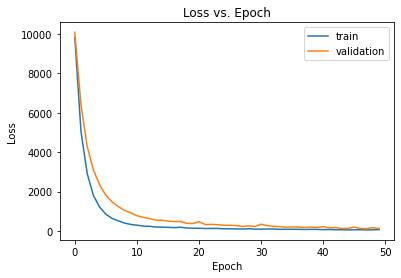

In [ ]:
# plot history
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='validation')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epoch')
plt.legend()
plt.show()

In [ ]:
#Saving the model
model.save("Tuned_LSTM_model.h5")
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_2 (Dense)             (None, 3, 50)             1250      
                                                                 
 lstm_6 (LSTM)               (None, 225)               248400    
                                                                 
 dropout_4 (Dropout)         (None, 225)               0         
                                                                 
 dense_3 (Dense)             (None, 1)                 226       
                                                                 
Total params: 249,876
Trainable params: 249,876
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# make a prediction
Pred_y = model.predict(test_X)

# calculate RMSE
rmse = sqrt(mean_squared_error(Pred_y, test_y))
print('Test RMSE: %.3f' % rmse)

Test RMSE: 18.751


18.750892719633462
5.205570780214899


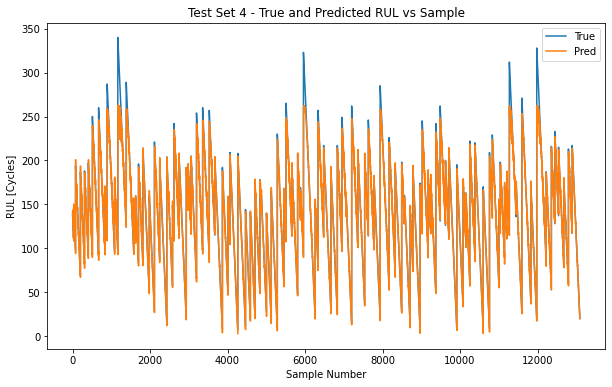

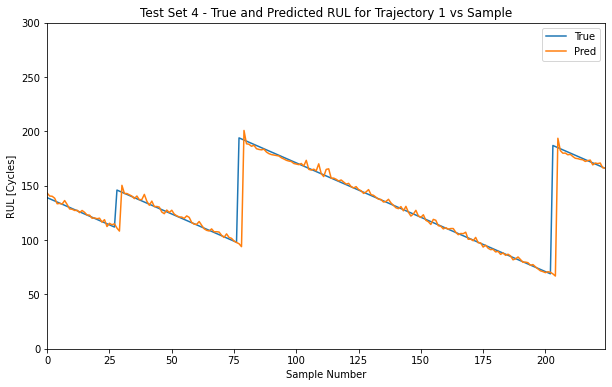

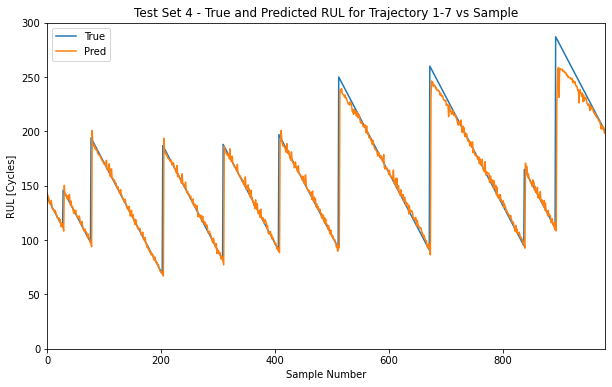

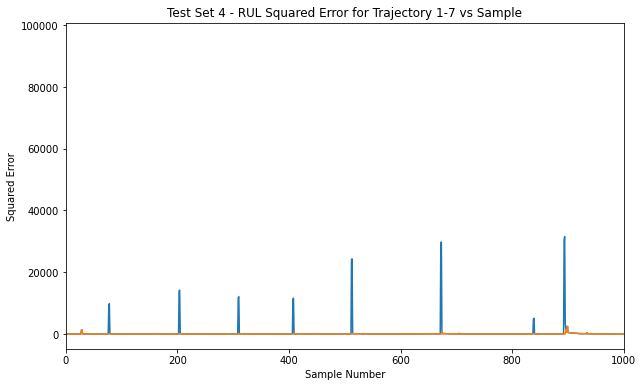

In [ ]:
# plot prediction and real result
plt.figure(figsize=(10,6))
plt.plot(test_y, label='True')
plt.plot(Pred_y, label='Pred')
plt.ylabel('RUL [Cycles]')
plt.xlabel('Sample Number')
plt.title('Test Set 4 - True and Predicted RUL vs Sample')
plt.legend()

# plot prediction and real result, traj1
plt.figure(figsize=(10,6))
plt.plot(test_y, label='True')
plt.plot(Pred_y, label='Pred')
plt.ylabel('RUL [Cycles]')
plt.xlabel('Sample Number')
plt.xlim([0,224])
plt.ylim([0,300])
plt.title('Test Set 4 - True and Predicted RUL for Trajectory 1 vs Sample')
plt.legend()

# plot prediction and real result, traj1
plt.figure(figsize=(10,6))
plt.plot(test_y, label='True')
plt.plot(Pred_y, label='Pred')
plt.ylabel('RUL [Cycles]')
plt.xlabel('Sample Number')
plt.xlim([0,980])
plt.ylim([0,300])
plt.title('Test Set 4 - True and Predicted RUL for Trajectory 1-7 vs Sample')
plt.legend()

plt.figure(figsize=(10,6))
err=test_y.flatten()-Pred_y.flatten()
sqerr=np.square(err)
sqerr_lim=sqerr
sqerr_lim[sqerr_lim>2500]=0
err=test_y.flatten()-Pred_y.flatten()
sqerr=np.square(err)
plt.plot(sqerr)
plt.plot(sqerr_lim)
plt.ylabel('Squared Error')
plt.xlabel('Sample Number')
plt.xlim([0,1000])
#plt.ylim([0,300])
plt.title('Test Set 4 - RUL Squared Error for Trajectory 1-7 vs Sample')
print(sqrt(sqerr.mean()))
print(sqrt(sqerr_lim.mean()))

In [ ]:
# evaluate the final lines of RUL test set
# add placeholder for three empty first rows to make the row numbers line up
p = np.array([['NA'], ['NA'], ['NA']])
Pred_y_shift = np.vstack((p, Pred_y))
# the datasets can be changed based on which set and preprocessing level is 
# being evaluated
df_test_1_prep = df_test_1_prep.assign(Pred_RUL = Pred_y_shift)
Pred_y_last = df_test_1_prep.groupby('Trajectory').last().reset_index().astype('float32')
# calculate RMSE on final RUL values for each trajectory
rmse = sqrt(mean_squared_error(Pred_y_last.Pred_RUL, df_test_rul_1))
print('Test RMSE: %.3f' % rmse)

Test RMSE: 2.154


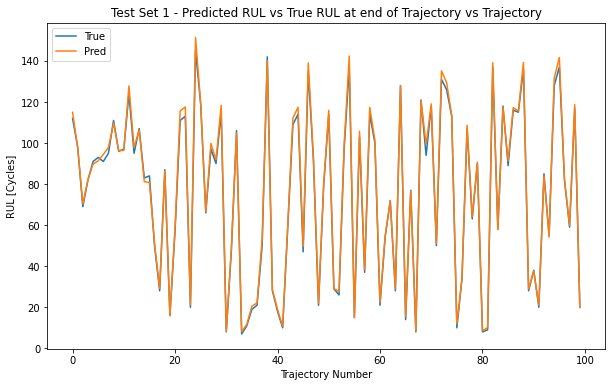

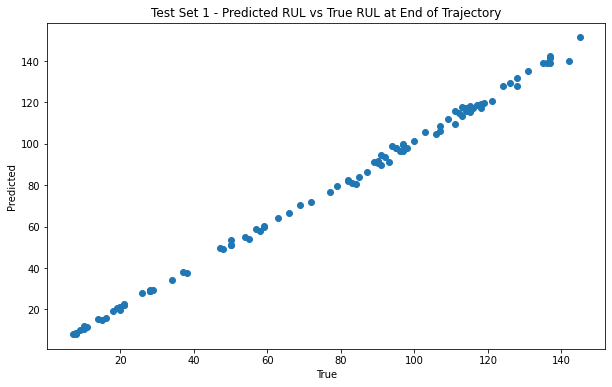

In [ ]:
# plot prediction and real result
plt.figure(figsize=(10,6))
plt.plot(df_test_rul_1, label='True')
plt.plot(Pred_y_last.Pred_RUL.values , label='Pred')
plt.ylabel('RUL [Cycles]')
plt.xlabel('Trajectory Number')
plt.legend()
plt.title('Test Set 1 - Predicted RUL vs True RUL at end of Trajectory vs Trajectory')
plt.show()

plt.figure(figsize=(10,6))
plt.scatter(df_test_rul_1,Pred_y_last.Pred_RUL.values)
plt.ylabel('Predicted')
plt.xlabel('True')
plt.title('Test Set 1 - Predicted RUL vs True RUL at End of Trajectory')
plt.show()

# 2D CNN - Nianyu Jiang, uploaded at 05/12

In [ ]:
%matplotlib inline
import os
seed = 42
os.environ['PYTHONHASHSEED']=str(seed)

import pandas as pd
import numpy as np
import random
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()

from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GroupShuffleSplit

import tensorflow as tf
from tensorflow.keras import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, Masking, TimeDistributed

import torch as th
import torchvision
import torchvision.transforms as transforms
from torch.utils.data.sampler import SubsetRandomSampler
import torch.nn as nn # https://pytorch.org/docs/stable/nn.html
import torch.nn.functional as F # https://pytorch.org/docs/stable/nn.functional.htmls

random.seed(seed)
np.random.seed(seed)
tf.random.set_seed(seed)
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# fix seed for reproduceable result

if th.cuda.is_available():
  # Make CuDNN Determinist
  th.backends.cudnn.deterministic = True
  th.cuda.manual_seed(seed)

# Define default device, we should use the GPU (cuda) if available
device = th.device("cuda" if th.cuda.is_available() else "cpu")

In [ ]:
# define column names for easy indexing
index_names = ['unit_nr', 'time_cycles']
setting_names = ['setting_1', 'setting_2', 'setting_3']
sensor_names = ['s_{}'.format(i) for i in range(1,22)] 
col_names = index_names + setting_names + sensor_names

# read data, engine 1 for the first try
train1=pd.read_table('drive/MyDrive/ME592/Final/train_FD001.txt',delimiter='\s+',header=None,names=col_names)
train2=pd.read_table('drive/MyDrive/ME592/Final/train_FD002.txt',delimiter='\s+',header=None,names=col_names)
train3=pd.read_table('drive/MyDrive/ME592/Final/train_FD003.txt',delimiter='\s+',header=None,names=col_names)
train4=pd.read_table('drive/MyDrive/ME592/Final/train_FD004.txt',delimiter='\s+',header=None,names=col_names)

test1=pd.read_table('drive/MyDrive/ME592/Final/test_FD001.txt',delimiter='\s+',header=None,names=col_names)
y_test1=pd.read_table('drive/MyDrive/ME592/Final/RUL_FD001.txt',delimiter='\s+',header=None,names=['RUL'])
test2=pd.read_table('drive/MyDrive/ME592/Final/test_FD002.txt',delimiter='\s+',header=None,names=col_names)
y_test2=pd.read_table('drive/MyDrive/ME592/Final/RUL_FD002.txt',delimiter='\s+',header=None,names=['RUL'])
test3=pd.read_table('drive/MyDrive/ME592/Final/test_FD003.txt',delimiter='\s+',header=None,names=col_names)
y_test3=pd.read_table('drive/MyDrive/ME592/Final/RUL_FD003.txt',delimiter='\s+',header=None,names=['RUL'])
test4=pd.read_table('drive/MyDrive/ME592/Final/test_FD004.txt',delimiter='\s+',header=None,names=col_names)
y_test4=pd.read_table('drive/MyDrive/ME592/Final/RUL_FD004.txt',delimiter='\s+',header=None,names=['RUL'])

In [ ]:
def add_remaining_useful_life(df): # add RUL to the last column of the train dataset
    # Get the total number of cycles for each unit
    grouped_by_unit = df.groupby(by="unit_nr")
    max_cycle = grouped_by_unit["time_cycles"].max()
    
    # Merge the max cycle back into the original frame
    result_frame = df.merge(max_cycle.to_frame(name='max_cycle'), left_on='unit_nr', right_index=True)
    
    # Calculate remaining useful life for each row
    remaining_useful_life = result_frame["max_cycle"] - result_frame["time_cycles"]
    result_frame["RUL"] = remaining_useful_life
    
    # drop max_cycle as it's no longer needed
    result_frame = result_frame.drop("max_cycle", axis=1)
    return result_frame
  
train1 = add_remaining_useful_life(train1)
train2 = add_remaining_useful_life(train2)
train3 = add_remaining_useful_life(train3)
train4 = add_remaining_useful_life(train4)
train1[index_names+['RUL']].head()

,unit_nr,time_cycles,RUL
0,1,1,191
1,1,2,190
2,1,3,189
3,1,4,188
4,1,5,187


In [ ]:
def add_remaining_useful_life_totest(df,y_test): # add RUL to the test dataset
    # Get the total number of cycles for each unit
    y_test.index = np.arange(1, len(y_test) + 1)
    grouped_by_unit = df.groupby(by="unit_nr")
    max_cycle_test = grouped_by_unit["time_cycles"].max()
    test_frame = max_cycle_test.to_frame(name='max_cycle_test')
    max_cycle = test_frame["max_cycle_test"] + y_test["RUL"]
    
    # Merge the max cycle back into the original frame
    result_frame = df.merge(max_cycle.to_frame(name='max_cycle'), left_on='unit_nr', right_index=True)
    
    # Calculate remaining useful life for each row
    remaining_useful_life = result_frame["max_cycle"] - result_frame["time_cycles"]
    result_frame["RUL"] = remaining_useful_life
    
    # drop max_cycle as it's no longer needed
    result_frame = result_frame.drop("max_cycle", axis=1)
    return result_frame
  
test1 = add_remaining_useful_life_totest(test1,y_test1)
test2 = add_remaining_useful_life_totest(test2,y_test2)
test3 = add_remaining_useful_life_totest(test3,y_test3)
test4 = add_remaining_useful_life_totest(test4,y_test4)

test1[index_names+['RUL']].head()

,unit_nr,time_cycles,RUL
0,1,1,142
1,1,2,141
2,1,3,140
3,1,4,139
4,1,5,138


In [ ]:
# Drop the sensor which give no useful info
remaining_sensors = ['s_2', 's_3', 's_4', 's_7', 's_8', 's_9',
       's_11', 's_12', 's_13', 's_14', 's_15', 's_17', 's_20', 's_21']
drop_sensors = [element for element in sensor_names if element not in remaining_sensors]

In [ ]:
def add_operating_condition(df):
    df_op_cond = df.copy()
    
    df_op_cond['setting_1'] = df_op_cond['setting_1'].round()
    df_op_cond['setting_2'] = df_op_cond['setting_2'].round(decimals=2)
    
    # converting settings to string and concatanating makes the operating condition into a categorical variable
    df_op_cond['op_cond'] = df_op_cond['setting_1'].astype(str) + '_' + \
                df_op_cond['setting_2'].astype(str) + '_' + \
                df_op_cond['setting_3'].astype(str)
    
    return df_op_cond

def condition_scaler(df_train, df_test, sensor_names):
    # apply operating condition specific scaling
    scaler = StandardScaler()
    for condition in df_train['op_cond'].unique():
        scaler.fit(df_train.loc[df_train['op_cond']==condition, sensor_names])
        df_train.loc[df_train['op_cond']==condition, sensor_names] = scaler.transform(df_train.loc[df_train['op_cond']==condition, sensor_names])
        df_test.loc[df_test['op_cond']==condition, sensor_names] = scaler.transform(df_test.loc[df_test['op_cond']==condition, sensor_names])
    return df_train, df_test

In [ ]:
# Using exponential smooth to reduce the error
def exponential_smoothing(df, sensors, n_samples, alpha=0.4):
    df = df.copy()
    # first, take the exponential weighted mean
    df[sensors] = df.groupby('unit_nr')[sensors].apply(lambda x: x.ewm(alpha=alpha).mean())
    
    # second, drop first n_samples of each unit_nr to reduce filter delay
    def create_mask(data, samples):
        result = np.ones_like(data)
        result[0:samples] = 0
        return result
    
    mask = df.groupby('unit_nr')['unit_nr'].transform(create_mask, samples=n_samples).astype(bool)
    df = df[mask]
    
    return df

In [ ]:
# split the data based on unit_numbers, not randomly split
gss = GroupShuffleSplit(n_splits=1, train_size=1.00)  # eventhough we set np and tf seeds, gss requires its own seed

def train_val_group_split(X, y, gss, groups, print_groups=True):
    
    for idx_train, idx_val in gss.split(X, y, groups=groups):
        if print_groups:
            print('train_split_engines', train.iloc[idx_train]['unit_nr'].unique())
            print('validate_split_engines', train.iloc[idx_val]['unit_nr'].unique(), '\n')

        X_train_split = X.iloc[idx_train].copy()
        y_train_split = y.iloc[idx_train].copy()
        X_val_split = X.iloc[idx_val].copy()
        y_val_split = y.iloc[idx_val].copy()
    return X_train_split, y_train_split, X_val_split, y_val_split

In [ ]:
# Generate the training data sequence
def gen_train_data(df, sequence_length, columns):
    data = df[columns].values
    num_elements = data.shape[0]

    # -1 and +1 because of Python indexing
    for start, stop in zip(range(0, num_elements-(sequence_length-1)), range(sequence_length, num_elements+1)):
        yield data[start:stop, :]

In [ ]:
def gen_data_wrapper(df, sequence_length, columns, unit_nrs=np.array([])):
    if unit_nrs.size <= 0:
        unit_nrs = df['unit_nr'].unique()
        
    data_gen = (list(gen_train_data(df[df['unit_nr']==unit_nr], sequence_length, columns))
               for unit_nr in unit_nrs)
    data_array = np.concatenate(list(data_gen)).astype(np.float32)
    return data_array

In [ ]:
def gen_labels(df, sequence_length, label):
    data_matrix = df[label].values
    num_elements = data_matrix.shape[0]

    # -1 because I want to predict the rul of that last row in the sequence, not the next row
    return data_matrix[sequence_length-1:num_elements, :]  

def gen_label_wrapper(df, sequence_length, label, unit_nrs=np.array([])):
    if unit_nrs.size <= 0:
        unit_nrs = df['unit_nr'].unique()
        
    label_gen = [gen_labels(df[df['unit_nr']==unit_nr], sequence_length, label) 
                for unit_nr in unit_nrs]
    label_array = np.concatenate(label_gen).astype(np.float32)
    return label_array

In [ ]:
def gen_test_data(df, sequence_length, columns, mask_value):
    if df.shape[0] < sequence_length:
        data_matrix = np.full(shape=(sequence_length, len(columns)), fill_value=mask_value) # pad
        idx = data_matrix.shape[0] - df.shape[0]
        data_matrix[idx:,:] = df[columns].values  # fill with available data
    else:
        data_matrix = df[columns].values
        
    # specifically yield the last possible sequence
    stop = num_elements = data_matrix.shape[0]
    start = stop - sequence_length
    for i in list(range(1)):
        yield data_matrix[start:stop, :]  

In [ ]:
# Do the sequencing and padding for all the data based on unit_number

sequence_length = 4
# Clip the RUL to 125
train1['RUL'].clip(upper=125, inplace=True)
test1['RUL'].clip(upper=125, inplace=True)

train2['RUL'].clip(upper=125, inplace=True)
test2['RUL'].clip(upper=125, inplace=True)

train3['RUL'].clip(upper=125, inplace=True)
test3['RUL'].clip(upper=125, inplace=True)

train4['RUL'].clip(upper=125, inplace=True)
test4['RUL'].clip(upper=125, inplace=True)

def data_prepare(train, test):
  X_train_interim = add_operating_condition(train.drop(drop_sensors, axis=1))
  X_test_interim = add_operating_condition(test.drop(drop_sensors, axis=1))
  X_train_interim, X_test_interim = condition_scaler(X_train_interim, X_test_interim, remaining_sensors)
  X_train_interim = exponential_smoothing(X_train_interim, remaining_sensors, 0, 0.4)
  X_test_interim = exponential_smoothing(X_test_interim, remaining_sensors, 0, 0.4)
  train_array = gen_data_wrapper(X_train_interim, sequence_length, remaining_sensors)
  train_label_array = gen_label_wrapper(X_train_interim, sequence_length, ['RUL'])
  test_array = gen_data_wrapper(X_test_interim, sequence_length, remaining_sensors)
  test_label_array = gen_label_wrapper(X_test_interim, sequence_length, ['RUL'])

  return train_array, train_label_array, test_array, test_label_array

In [ ]:
train1_array, train1_label_array, test1_array, test1_label_array = data_prepare(train1, test1)
train2_array, train2_label_array, test2_array, test2_label_array = data_prepare(train2, test2)
train3_array, train3_label_array, test3_array, test3_label_array = data_prepare(train3, test3)
train4_array, train4_label_array, test4_array, test4_label_array = data_prepare(train4, test4)

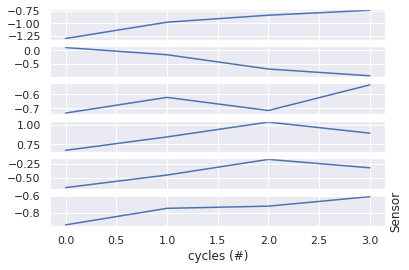

In [ ]:
# plt.plot(train1_array[1,:,:])
plt.plot()

i = 0
for i in range(len(train1_array[1,1,:])-8):
	axr = plt.subplot(train1_array.shape[2]-8, 1, i+1)
	plt.plot(train1_array[1,:,i])
	# plt.title("Data Structure", y=0.5, loc='right')
	i += 1

axr.yaxis.set_label_position("right")
plt.ylabel("Sensor")
plt.xlabel("cycles (#)")
plt.show()

In [ ]:
train1_array.shape, train1_label_array.shape, test1_array.shape, test1_label_array.shape

((20331, 4, 14), (20331, 1), (12796, 4, 14), (12796, 1))

In [ ]:
train_array = train4_array[0:(train4_array.shape[0]//1000)*1000,:,:]
train_label_array= train4_label_array[0:(train4_array.shape[0]//1000)*1000,:]

In [ ]:
n_training_samples = int(0.6*len(train_array))
n_val_samples = len(train_array) - n_training_samples

train_sampler = SubsetRandomSampler(np.arange(n_training_samples, dtype=np.int64))
val_sampler = SubsetRandomSampler(np.arange(n_training_samples, n_training_samples + n_val_samples, dtype=np.int64))

In [ ]:
train_array = train_array.reshape(train_array.shape[0], 1, train_array.shape[1], train_array.shape[2])
train_array = th.tensor(train_array)
train_label_array = th.tensor(train_label_array)

In [ ]:
train_set = th.utils.data.TensorDataset(train_array,train_label_array)

In [ ]:
def get_train_loader(batch_size):
    return th.utils.data.DataLoader(train_set, batch_size=batch_size, sampler=train_sampler)

val_loader = th.utils.data.DataLoader(train_set, batch_size = 16, sampler=val_sampler)

In [ ]:
import torch.optim as optim

def createLossAndOptimizer(net, learning_rate=0.001): # define a optimizer with crossentropy as loss and Adam as optimizer
    # it combines softmax with negative log likelihood loss
    criterion = nn.MSELoss()  
    #optimizer = optim.SGD(net.parameters(), lr=learning_rate, momentum=0.9)
    optimizer = optim.Adam(net.parameters(), lr=learning_rate)
    return criterion, optimizer

In [ ]:
# build up the CNN model
class CNN(nn.Module):
    def __init__(self):
        super(CNN, self).__init__()
        
        # see https://madebyollin.github.io/convnet-calculator/ for size calculation
        self.conv1 = nn.Conv2d(1, 8, kernel_size=3, stride=1, padding=1) # 1x14x10 -> 16x14x10
        self.conv2 = nn.Conv2d(8, 16, kernel_size=1, stride=1, padding=0) # 16x14x10 -> 32x14x10
        self.conv3 = nn.Conv2d(16, 32, kernel_size=1, stride=1, padding=0) # 16x14x10 -> 32x14x10
        self.pool1 = nn.MaxPool2d(kernel_size=3, stride=1, padding=1) # 1 -> 1 size changed
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2, padding=0) # 2 -> 1 size changed
        
        # cf comments in forward() to have step by step comments
        # on the shape (how we pass from a 3x32x32 input image to a 18x16x16 volume)
        self.fc1 = nn.Linear(32 * 3 * 1, 32) # fully connected layers, down to 64 features
        self.fc2 = nn.Linear(32, 1) # another fully connected layers, down to 10 features which corresponding to 10 labels
        # self.sf1 = nn.Softmax(dim=1)
        # self.fc3 = nn.Linear(10, 1) # another fully connected layers, down to 1 features which corresponding to RUL

    def forward(self, x): # Define the forward step of NN
        """
        Forward pass,
        x shape is (batch_size, 3, 32, 32)
        (color channel first)
        in the comments, we omit the batch_size in the shape
        """
        # shape : 1x14x20 -> 16x14x20
        x = F.relu(self.conv1(x))   
        # x = self.pool2(x)

        # shape : 16x14x20 -> 64x14x20
        x = F.relu(self.conv2(x))
        # 64x14x20 -> 64x7x10
        x = self.pool2(x)
        # shape : 16x14x20 -> 64x14x20
        x = F.relu(self.conv3(x))

        x = self.pool2(x)     
        # 16x7x10 -> 16x7x10
        x = x.view(-1, 32 * 3 * 1)
        # 64 * 7 * 10 - > 64
        x = F.relu(self.fc1(x))
        # 64 -> 1
        # The softmax non-linearity is applied later (cf createLossAndOptimizer() fn)
        x = self.fc2(x)
        # x = self.sf1(x)
        return x

In [ ]:
import itertools
import time

def train(net, batch_size, n_epochs, learning_rate):
    """
    Train a neural network and print statistics of the training
    
    :param net: (PyTorch Neural Network)
    :param batch_size: (int)
    :param n_epochs: (int)  Number of iterations on the training set
    :param learning_rate: (float) learning rate used by the optimizer
    """
    print("===== HYPERPARAMETERS =====")
    print("batch_size=", batch_size)
    print("n_epochs=", n_epochs)
    print("learning_rate=", learning_rate)
    print("=" * 30)

    train_loader = get_train_loader(batch_size)
    n_minibatches = len(train_loader) # set the minibatch size

    criterion, optimizer = createLossAndOptimizer(net, learning_rate)
    # Init variables used for plotting the loss
    train_history = []
    val_history = []

    training_start_time = time.time()
    best_error = np.inf
    best_model_path = "best_model.pth"
    
    # Move model to gpu if possible
    net = net.to(device)

    for epoch in range(n_epochs):  # loop over the dataset multiple times

        running_loss = 0.0
        print_every = n_minibatches // 10
        start_time = time.time()
        total_train_loss = 0
        
        for i, (inputs, labels) in enumerate(train_loader): # get a counter and the value from the iterable at the same time

            # Move tensors to correct device
            inputs, labels = inputs.to(device), labels.to(device)

            # zero the parameter gradients
            optimizer.zero_grad()

            # forward + backward + optimize
            outputs = net(inputs) # use NN to get predicted output
            # loss = criterion(outputs, labels) # crossentropy loss for criterion
            loss = th.sqrt(criterion(outputs, labels))
            loss.backward()
            # loss.backward() # back propagation
            optimizer.step() # use optimizer to optimize (update the W) https://pytorch.org/docs/stable/optim.html

            # print statistics
            running_loss += loss.item() # .item() returns a view object that displays a list of a given dictionary's (key, value) tuple pair
            total_train_loss += loss.item()

            # print every 10th of epoch
            if (i + 1) % (print_every + 1) == 0:    
                print("Epoch {}, {:d}% \t train_loss: {:.2f} took: {:.2f}s".format(
                      epoch + 1, int(100 * (i + 1) / n_minibatches), running_loss / print_every,
                      time.time() - start_time))
                running_loss = 0.0 # zero the running loss
                start_time = time.time()

        train_history.append(total_train_loss / len(train_loader))

        total_val_loss = 0
        # Do a pass on the validation set
        # We don't need to compute gradient,
        # we save memory and computation using th.no_grad()
        with th.no_grad():
          for inputs, labels in val_loader:
              # Move tensors to correct device
              inputs, labels = inputs.to(device), labels.to(device)
              # Forward pass
              predictions = net(inputs)
              val_loss = th.sqrt(criterion(outputs, labels))
              total_val_loss += val_loss.item()
            
        val_history.append(total_val_loss / len(val_loader))
        # Save model that performs best on validation set
        if total_val_loss < best_error:
            best_error = total_val_loss
            th.save(net.state_dict(), best_model_path)

        print("Validation loss = {:.2f}".format(total_val_loss / len(val_loader)))

    print("Training Finished, took {:.2f}s".format(time.time() - training_start_time))
    
    # Load best model
    net.load_state_dict(th.load(best_model_path))
    
    return train_history, val_history

In [ ]:
net = CNN()

train_history, val_history = train(net, batch_size = 16, n_epochs=20, learning_rate=0.001)

===== HYPERPARAMETERS =====
batch_size= 16
n_epochs= 20
learning_rate= 0.001
Epoch 1, 10% 	 train_loss: 58.26 took: 0.79s
Epoch 1, 20% 	 train_loss: 29.26 took: 0.62s
Epoch 1, 30% 	 train_loss: 22.89 took: 0.64s
Epoch 1, 40% 	 train_loss: 20.18 took: 0.63s
Epoch 1, 50% 	 train_loss: 18.96 took: 0.60s
Epoch 1, 60% 	 train_loss: 18.66 took: 0.60s
Epoch 1, 70% 	 train_loss: 18.47 took: 0.61s
Epoch 1, 80% 	 train_loss: 18.17 took: 0.60s
Epoch 1, 90% 	 train_loss: 18.49 took: 0.60s
Validation loss = 51.49
Epoch 2, 10% 	 train_loss: 17.64 took: 0.80s
Epoch 2, 20% 	 train_loss: 17.40 took: 0.61s
Epoch 2, 30% 	 train_loss: 17.57 took: 0.63s
Epoch 2, 40% 	 train_loss: 17.90 took: 0.76s
Epoch 2, 50% 	 train_loss: 17.33 took: 0.62s
Epoch 2, 60% 	 train_loss: 17.77 took: 0.61s
Epoch 2, 70% 	 train_loss: 17.77 took: 0.64s
Epoch 2, 80% 	 train_loss: 17.29 took: 0.61s
Epoch 2, 90% 	 train_loss: 17.21 took: 0.63s
Validation loss = 51.03
Epoch 3, 10% 	 train_loss: 17.02 took: 0.61s
Epoch 3, 20% 	 train

In [ ]:
# prepare the test data
def test_to_tensor (test_array): 
  test_array = test_array.reshape(test_array.shape[0], 1, test_array.shape[1], test_array.shape[2])
  test_array = th.tensor(test_array)
  return test_array

test1_tensor = test_to_tensor(test1_array)
test2_tensor = test_to_tensor(test2_array)
test3_tensor = test_to_tensor(test3_array)
test4_tensor = test_to_tensor(test4_array)

In [ ]:
# define the evaluation process
def evaluate(y_true, y_hat, label='test'):
    mse = mean_squared_error(y_true, y_hat)
    rmse = np.sqrt(mse)
    variance = r2_score(y_true, y_hat)
    print('{} set RMSE:{}, Variance:{}'.format(label, rmse, variance))

In [ ]:
test1_tensor.shape, test1_label_array.shape

(torch.Size([12796, 1, 4, 14]), (12796, 1))

In [ ]:
y_hat_test = net(test1_tensor)

In [ ]:
# predict and evaluate
# y_hat_train = net(train_array)
# evaluate(label_array, y_hat_train, 'train')
def test_result (test_tensor, test_label):
  y_hat_test = net(test_tensor)
  y_hat_test = y_hat_test.detach().numpy()
  evaluate(test_label, y_hat_test)

test_result (test1_tensor, test1_label_array)
test_result (test2_tensor, test2_label_array)
test_result (test3_tensor, test3_label_array)
test_result (test4_tensor, test4_label_array)

test set RMSE:20.272735595703125, Variance:0.46780351012156873
test set RMSE:19.525766372680664, Variance:0.547903013004092
test set RMSE:16.161216735839844, Variance:0.5822448305143967
test set RMSE:16.865100860595703, Variance:0.5673798415649027


In [ ]:
from torchvision import models
from torchsummary import summary
batch_size = 16
model = CNN()
summary(model,input_size=(1, 4, 14))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1             [-1, 8, 4, 14]              80
            Conv2d-2            [-1, 16, 4, 14]             144
         MaxPool2d-3             [-1, 16, 2, 7]               0
            Conv2d-4             [-1, 32, 2, 7]             544
         MaxPool2d-5             [-1, 32, 1, 3]               0
            Linear-6                   [-1, 32]           3,104
            Linear-7                    [-1, 1]              33
Total params: 3,905
Trainable params: 3,905
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.00
Forward/backward pass size (MB): 0.02
Params size (MB): 0.01
Estimated Total Size (MB): 0.03
----------------------------------------------------------------


# CNN+LSTM

In [ ]:
import keras
from keras.layers.core import Activation
from keras.models import Sequential,load_model
from keras.layers import Dense, Dropout, LSTM
from tensorflow.keras.utils import plot_model
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import pandas as pd
import math
from sklearn import preprocessing
from sklearn.metrics import mean_squared_error, r2_score
from keras.layers.convolutional import Conv1D
from keras.layers.convolutional import MaxPooling1D

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# define column names for easy indexing
index_names = ['engine', 'cycle']
setting_names = ['setting_1', 'setting_2', 'setting_3']
sensor_names = ['s_{}'.format(i) for i in range(1,22)] 
col_names = index_names + setting_names + sensor_names

# read data, I focused on engine 1 for the first try
train_df=pd.read_table('drive/MyDrive/ME592/Final/train_FD001.txt',delimiter='\s+',header=None,names=col_names)
test_df=pd.read_table('drive/MyDrive/ME592/Final/test_FD001.txt',delimiter='\s+',header=None,names=col_names)
real_df=pd.read_table('drive/MyDrive/ME592/Final/RUL_FD001.txt',delimiter='\s+',header=None,names=['RUL'])

print(train_df.shape,test_df.shape,real_df.shape)

(20631, 26) (13096, 26) (100, 1)


In [ ]:
def add_remaining_useful_life(df):

    grouped_by_unit = df.groupby(by="engine")
    max_cycle = grouped_by_unit["cycle"].max()
    result_frame = df.merge(max_cycle.to_frame(name='max_cycle'), left_on='engine', right_index=True)
    remaining_useful_life = result_frame["max_cycle"] - result_frame["cycle"]
    result_frame["RUL"] = remaining_useful_life
    result_frame = result_frame.drop("max_cycle", axis=1)
    return result_frame


train_df = add_remaining_useful_life(train_df)


# MinMax normalization

train_df['cycle_2'] = train_df['cycle']
cols_normalize = train_df.columns.difference(['engine','cycle','RUL'])

min_max_scaler = preprocessing.MinMaxScaler()
norm_train_df = pd.DataFrame(min_max_scaler.fit_transform(train_df[cols_normalize]), columns=cols_normalize, index=train_df.index)

join_df = train_df[train_df.columns.difference(cols_normalize)].join(norm_train_df)
train_df = join_df.reindex(columns = train_df.columns)

#Did not drop in order to avoid repetition in test set

train_df

,engine,cycle,setting_1,setting_2,setting_3,s_1,s_2,s_3,s_4,s_5,...,s_14,s_15,s_16,s_17,s_18,s_19,s_20,s_21,RUL,cycle_2
0,1,1,0.459770,0.166667,0.0,0.0,0.183735,0.406802,0.309757,0.0,...,0.199608,0.363986,0.0,0.333333,0.0,0.0,0.713178,0.724662,191,0.000000
1,1,2,0.609195,0.250000,0.0,0.0,0.283133,0.453019,0.352633,0.0,...,0.162813,0.411312,0.0,0.333333,0.0,0.0,0.666667,0.731014,190,0.002770
2,1,3,0.252874,0.750000,0.0,0.0,0.343373,0.369523,0.370527,0.0,...,0.171793,0.357445,0.0,0.166667,0.0,0.0,0.627907,0.621375,189,0.005540
3,1,4,0.540230,0.500000,0.0,0.0,0.343373,0.256159,0.331195,0.0,...,0.174889,0.166603,0.0,0.333333,0.0,0.0,0.573643,0.662386,188,0.008310
4,1,5,0.390805,0.333333,0.0,0.0,0.349398,0.257467,0.404625,0.0,...,0.174734,0.402078,0.0,0.416667,0.0,0.0,0.589147,0.704502,187,0.011080
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,0.477011,0.250000,0.0,0.0,0.686747,0.587312,0.782917,0.0,...,0.194344,0.656791,0.0,0.750000,0.0,0.0,0.271318,0.109500,4,0.540166
20627,100,197,0.408046,0.083333,0.0,0.0,0.701807,0.729453,0.866475,0.0,...,0.188668,0.727203,0.0,0.583333,0.0,0.0,0.124031,0.366197,3,0.542936
20628,100,198,0.522989,0.500000,0.0,0.0,0.665663,0.684979,0.775321,0.0,...,0.212148,0.922278,0.0,0.833333,0.0,0.0,0.232558,0.053991,2,0.545706
20629,100,199,0.436782,0.750000,0.0,0.0,0.608434,0.746021,0.747468,0.0,...,0.203065,0.823394,0.0,0.583333,0.0,0.0,0.116279,0.234466,1,0.548476


In [ ]:

#Test Data

# normalization
test_df['cycle_2'] = test_df['cycle']
norm_test_df = pd.DataFrame(min_max_scaler.transform(test_df[cols_normalize]), columns=cols_normalize, index=test_df.index)
test_join_df = test_df[test_df.columns.difference(cols_normalize)].join(norm_test_df)
test_df = test_join_df.reindex(columns = test_df.columns)
test_df = test_df.reset_index(drop=True)


# create a column 'max' for the test data
rul = pd.DataFrame(test_df.groupby('engine')['cycle'].max()).reset_index()
rul.columns = ['engine', 'max']
real_df.columns = ['more']
real_df['engine'] = real_df.index + 1
real_df['max'] = rul['max'] + real_df['more']
real_df.drop('more', axis=1, inplace=True)


# generate RUL for test data
test_df = test_df.merge(real_df, on=['engine'], how='left')
test_df['RUL'] = test_df['max'] - test_df['cycle']
test_df.drop('max', axis=1, inplace=True)
test_df

,engine,cycle,setting_1,setting_2,setting_3,s_1,s_2,s_3,s_4,s_5,...,s_14,s_15,s_16,s_17,s_18,s_19,s_20,s_21,cycle_2,RUL
0,1,1,0.632184,0.750000,0.0,0.0,0.545181,0.310661,0.269413,0.0,...,0.132160,0.308965,0.0,0.333333,0.0,0.0,0.558140,0.661834,0.000000,142
1,1,2,0.344828,0.250000,0.0,0.0,0.150602,0.379551,0.222316,0.0,...,0.204768,0.213159,0.0,0.416667,0.0,0.0,0.682171,0.686827,0.002770,141
2,1,3,0.517241,0.583333,0.0,0.0,0.376506,0.346632,0.322248,0.0,...,0.155640,0.458638,0.0,0.416667,0.0,0.0,0.728682,0.721348,0.005540,140
3,1,4,0.741379,0.500000,0.0,0.0,0.370482,0.285154,0.408001,0.0,...,0.170090,0.257022,0.0,0.250000,0.0,0.0,0.666667,0.662110,0.008310,139
4,1,5,0.580460,0.500000,0.0,0.0,0.391566,0.352082,0.332039,0.0,...,0.152751,0.300885,0.0,0.166667,0.0,0.0,0.658915,0.716377,0.011080,138
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13091,100,194,0.781609,0.500000,0.0,0.0,0.611446,0.619359,0.566172,0.0,...,0.584890,0.564063,0.0,0.500000,0.0,0.0,0.395349,0.418669,0.534626,24
13092,100,195,0.436782,0.416667,0.0,0.0,0.605422,0.537388,0.671843,0.0,...,0.572350,0.485956,0.0,0.583333,0.0,0.0,0.333333,0.528721,0.537396,23
13093,100,196,0.465517,0.250000,0.0,0.0,0.671687,0.482014,0.414754,0.0,...,0.605326,0.507888,0.0,0.583333,0.0,0.0,0.372093,0.429301,0.540166,22
13094,100,197,0.281609,0.583333,0.0,0.0,0.617470,0.522128,0.626435,0.0,...,0.622046,0.562524,0.0,0.583333,0.0,0.0,0.403101,0.518779,0.542936,21


In [ ]:
sequence_length = 100

def gen_sequence(engine_df, seq_length, seq_cols):
   
    data_array = engine_df[seq_cols].values
    num_elements = data_array.shape[0]

    for start, stop in zip(range(0, num_elements-seq_length), range(seq_length, num_elements)):
        yield data_array[start:stop, :]
        

In [ ]:

sensor_cols = ['s_' + str(i) for i in range(1,22)]
sequence_cols = ['setting_1', 'setting_2', 'setting_3', 'cycle_2']
sequence_cols.extend(sensor_cols)

# creating a sequence, each engine will end up sequence length (100) rows lesser
seq_gen = (list(gen_sequence(train_df[train_df['engine']==engine], sequence_length, sequence_cols)) for engine in train_df['engine'].unique())

# generate sequences and convert to np array
seq_array = np.concatenate(list(seq_gen)).astype(np.float32)
print(seq_array.shape)

(10631, 100, 25)


In [ ]:
#  labels
def gen_labels(engine_df, seq_length, label):
    data_array = engine_df[label].values
    num_elements = data_array.shape[0]
    return data_array[seq_length:num_elements, :]


label_gen = [gen_labels(train_df[train_df['engine']==engine], sequence_length, ['RUL']) for engine in train_df['engine'].unique()]


label_array = np.concatenate(label_gen).astype(np.float32)
print(label_array.shape)

(10631, 1)


In [ ]:


# Model


nb_features = seq_array.shape[2]
nb_out = label_array.shape[1]



# define CNN model
model = Sequential()
model.add(Conv1D(filters=100, kernel_size=3, activation="relu", input_shape=(sequence_length, nb_features)))
model.add(MaxPooling1D(pool_size=2))

# model.add(Conv1D(filters=36, kernel_size=2, activation='relu'))
# model.add(MaxPooling1D(pool_size=2))

# model.add(Conv1D(filters=72, kernel_size=2, activation='relu', padding='same'))
# model.add(MaxPooling1D(pool_size=2))


# define LSTM model
model.add(LSTM(units=100, return_sequences=True))
model.add(Dropout(0.2))

# model.add(LSTM(units=100, return_sequences=True))
# model.add(Dropout(0.2))

model.add(LSTM(units=50,return_sequences=False))
model.add(Dropout(0.2))

model.add(Dense(units=20))

model.add(Dense(units=nb_out))
model.add(Activation("linear"))
model.compile(loss='mean_squared_error', optimizer='adam',metrics=['mean_squared_error'])

print(model.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d (Conv1D)             (None, 98, 100)           7600      
                                                                 
 max_pooling1d (MaxPooling1D  (None, 49, 100)          0         
 )                                                               
                                                                 
 lstm (LSTM)                 (None, 49, 100)           80400     
                                                                 
 dropout (Dropout)           (None, 49, 100)           0         
                                                                 
 lstm_1 (LSTM)               (None, 50)                30200     
                                                                 
 dropout_1 (Dropout)         (None, 50)                0         
                                                        

In [ ]:
# fitting
history = model.fit(seq_array, label_array, epochs=20, batch_size=200, validation_split=0.1, verbose=2,
          callbacks = [ keras.callbacks.ModelCheckpoint("cnn_lstm.h5",monitor='val_loss', save_best_only=True, mode='min', verbose=0)])

#  --- early stopping----keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0, patience=10, verbose=0, mode='min'),

Epoch 1/20
48/48 - 21s - loss: 4353.3057 - mean_squared_error: 4353.3057 - val_loss: 5012.4536 - val_mean_squared_error: 5012.4536 - 21s/epoch - 447ms/step
Epoch 2/20
48/48 - 18s - loss: 2655.8672 - mean_squared_error: 2655.8672 - val_loss: 3627.1340 - val_mean_squared_error: 3627.1340 - 18s/epoch - 377ms/step
Epoch 3/20
48/48 - 16s - loss: 2168.0388 - mean_squared_error: 2168.0388 - val_loss: 3235.4221 - val_mean_squared_error: 3235.4221 - 16s/epoch - 333ms/step
Epoch 4/20
48/48 - 16s - loss: 2131.0742 - mean_squared_error: 2131.0742 - val_loss: 3201.9817 - val_mean_squared_error: 3201.9819 - 16s/epoch - 333ms/step
Epoch 5/20
48/48 - 16s - loss: 2125.2214 - mean_squared_error: 2125.2214 - val_loss: 3203.0435 - val_mean_squared_error: 3203.0435 - 16s/epoch - 339ms/step
Epoch 6/20
48/48 - 16s - loss: 2127.5830 - mean_squared_error: 2127.5830 - val_loss: 3203.5906 - val_mean_squared_error: 3203.5906 - 16s/epoch - 337ms/step
Epoch 7/20
48/48 - 16s - loss: 2127.0190 - mean_squared_error: 2

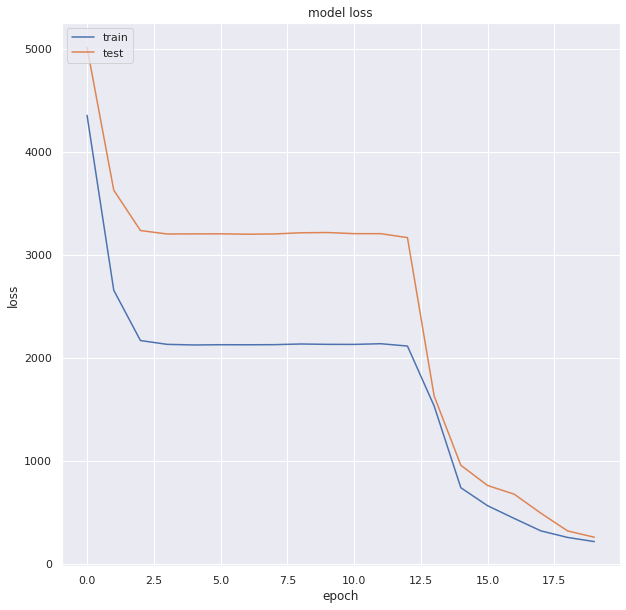

In [ ]:
# Loss
fig_acc = plt.figure(figsize=(10, 10))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


In [ ]:
# last sequence for each engine in the test data
seq_array_test_last = [test_df[test_df['engine']==engine][sequence_cols].values[-sequence_length:] for engine in test_df['engine'].unique() if len(test_df[test_df['engine']==engine]) >= sequence_length]
seq_array_test_last = np.asarray(seq_array_test_last).astype(np.float32)


#  labels
y_mask = [len(test_df[test_df['engine']==engine]) >= sequence_length for engine in test_df['engine'].unique()]
label_array_test_last = test_df.groupby('engine')['RUL'].nth(-1)[y_mask].values
label_array_test_last = label_array_test_last.reshape(label_array_test_last.shape[0],1).astype(np.float32)

test set RMSE:14.881437301635742, R2:0.8512244890891814


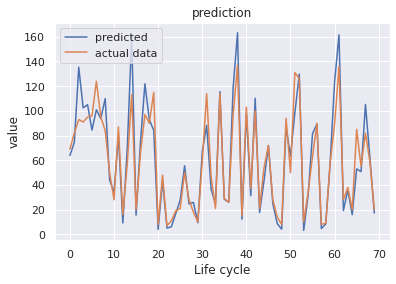

In [ ]:
# define the evaluation process
def evaluate(y_true, y_hat, label='test'):
    mse = mean_squared_error(y_true, y_hat)
    rmse = np.sqrt(mse)
    variance = r2_score(y_true, y_hat)
    print('{} set RMSE:{}, R2:{}'.format(label, rmse, variance))

best_model = load_model("cnn_lstm.h5")

y_pred_test = best_model.predict(seq_array_test_last)
y_true_test = label_array_test_last


rmse = evaluate(y_true_test,y_pred_test)



# Plot the predicted data and the actual data
plt.plot(y_pred_test)
plt.plot(y_true_test)
plt.title('prediction')
plt.ylabel('value')
plt.xlabel('Life cycle')
plt.legend(['predicted', 'actual data'], loc='upper left')
plt.show()

# CNN+LSTM

In [ ]:
import keras
from keras.layers.core import Activation
from keras.models import Sequential,load_model
from keras.layers import Dense, Dropout, LSTM
from tensorflow.keras.utils import plot_model
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import pandas as pd
import math
from sklearn import preprocessing
from sklearn.metrics import mean_squared_error, r2_score
from keras.layers.convolutional import Conv1D
from keras.layers.convolutional import MaxPooling1D

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
# define column names for easy indexing
index_names = ['engine', 'cycle']
setting_names = ['setting_1', 'setting_2', 'setting_3']
sensor_names = ['s_{}'.format(i) for i in range(1,22)] 
col_names = index_names + setting_names + sensor_names

# read data, I focused on engine 1 for the first try

train_df1=pd.read_table('drive/MyDrive/ME592/Final/train_FD001.txt',delimiter='\s+',header=None,names=col_names)
test_df1=pd.read_table('drive/MyDrive/ME592/Final/test_FD001.txt',delimiter='\s+',header=None,names=col_names)
real_df1=pd.read_table('drive/MyDrive/ME592/Final/RUL_FD001.txt',delimiter='\s+',header=None,names=['RUL'])

train_df2=pd.read_table('drive/MyDrive/ME592/Final/train_FD002.txt',delimiter='\s+',header=None,names=col_names)
test_df2=pd.read_table('drive/MyDrive/ME592/Final/test_FD002.txt',delimiter='\s+',header=None,names=col_names)
real_df2=pd.read_table('drive/MyDrive/ME592/Final/RUL_FD002.txt',delimiter='\s+',header=None,names=['RUL'])

train_df3=pd.read_table('drive/MyDrive/ME592/Final/train_FD003.txt',delimiter='\s+',header=None,names=col_names)
test_df3=pd.read_table('drive/MyDrive/ME592/Final/test_FD003.txt',delimiter='\s+',header=None,names=col_names)
real_df3=pd.read_table('drive/MyDrive/ME592/Final/RUL_FD003.txt',delimiter='\s+',header=None,names=['RUL'])

train_df4=pd.read_table('drive/MyDrive/ME592/Final/train_FD004.txt',delimiter='\s+',header=None,names=col_names)
test_df4=pd.read_table('drive/MyDrive/ME592/Final/test_FD004.txt',delimiter='\s+',header=None,names=col_names)
real_df4=pd.read_table('drive/MyDrive/ME592/Final/RUL_FD004.txt',delimiter='\s+',header=None,names=['RUL'])

print(train_df1.shape,test_df1.shape,real_df1.shape)

In [ ]:
def add_remaining_useful_life(df):

    grouped_by_unit = df.groupby(by="engine")
    max_cycle = grouped_by_unit["cycle"].max()
    result_frame = df.merge(max_cycle.to_frame(name='max_cycle'), left_on='engine', right_index=True)
    remaining_useful_life = result_frame["max_cycle"] - result_frame["cycle"]
    result_frame["RUL"] = remaining_useful_life
    result_frame = result_frame.drop("max_cycle", axis=1)
    return result_frame


train_df1 = add_remaining_useful_life(train_df1)
train_df2 = add_remaining_useful_life(train_df2)
train_df3 = add_remaining_useful_life(train_df3)
train_df4 = add_remaining_useful_life(train_df4)



# MinMax normalization
def normalization(train_df,test_df,real_df):

    train_df['cycle_2'] = train_df['cycle']
    cols_normalize = train_df.columns.difference(['engine','cycle','RUL'])

    min_max_scaler = preprocessing.MinMaxScaler()
    norm_train_df = pd.DataFrame(min_max_scaler.fit_transform(train_df[cols_normalize]), columns=cols_normalize, index=train_df.index)

    join_df = train_df[train_df.columns.difference(cols_normalize)].join(norm_train_df)
    train_df = join_df.reindex(columns = train_df.columns)

#Did not drop in order to avoid repetition in test set



# normalization for test
    test_df['cycle_2'] = test_df['cycle']
    norm_test_df = pd.DataFrame(min_max_scaler.transform(test_df[cols_normalize]), columns=cols_normalize, index=test_df.index)
    test_join_df = test_df[test_df.columns.difference(cols_normalize)].join(norm_test_df)
    test_df = test_join_df.reindex(columns = test_df.columns)
    test_df = test_df.reset_index(drop=True)


    # create a column 'max' for the test data
    rul = pd.DataFrame(test_df.groupby('engine')['cycle'].max()).reset_index()
    rul.columns = ['engine', 'max']
    real_df.columns = ['more']
    real_df['engine'] = real_df.index + 1
    real_df['max'] = rul['max'] + real_df['more']
    real_df.drop('more', axis=1, inplace=True)


    # generate RUL for test data
    test_df = test_df.merge(real_df, on=['engine'], how='left')
    test_df['RUL'] = test_df['max'] - test_df['cycle']
    test_df.drop('max', axis=1, inplace=True)

    return train_df,test_df

train_df1,test_df1 = normalization(train_df1,test_df1,real_df1)
train_df2,test_df2 = normalization(train_df2,test_df2,real_df2)
train_df3,test_df3 = normalization(train_df3,test_df3,real_df3)
train_df4,test_df4 = normalization(train_df4,test_df4,real_df4)

In [ ]:
sequence_length = 100

def gen_sequence(engine_df, seq_length, seq_cols):
   
    data_array = engine_df[seq_cols].values
    num_elements = data_array.shape[0]

    for start, stop in zip(range(0, num_elements-seq_length), range(seq_length, num_elements)):
        yield data_array[start:stop, :]
        

In [ ]:

sensor_cols = ['s_' + str(i) for i in range(1,22)]
sequence_cols = ['setting_1', 'setting_2', 'setting_3', 'cycle_2']
sequence_cols.extend(sensor_cols)

def create_sequence(train_df):
# creating a sequence, each engine will end up sequence length (100) rows lesser
  seq_gen = (list(gen_sequence(train_df[train_df['engine']==engine], sequence_length, sequence_cols)) for engine in train_df['engine'].unique())

# generate sequences
  seq_array = np.concatenate(list(seq_gen)).astype(np.float32)
  return seq_array

  print(seq_array.shape)


train_df1_seq = create_sequence(train_df1)
train_df2_seq = create_sequence(train_df2)
train_df3_seq = create_sequence(train_df3)
train_df4_seq = create_sequence(train_df4)

In [ ]:
#  labels
def gen_labels(engine_df, seq_length, label):
    data_array = engine_df[label].values
    num_elements = data_array.shape[0]
    return data_array[seq_length:num_elements, :]

def label_(train_df):
    label_gen = [gen_labels(train_df[train_df['engine']==engine], sequence_length, ['RUL']) for engine in train_df['engine'].unique()]

    label_array = np.concatenate(label_gen).astype(np.float32)
    return label_array
    print(label_array.shape)


train_df1_lab = label_(train_df1)
train_df2_lab = label_(train_df2)
train_df3_lab = label_(train_df3)
train_df4_lab = label_(train_df4)

In [ ]:
# Model


num=1
for seq_array, label_array in zip([train_df1_seq,train_df2_seq,train_df3_seq,train_df4_seq],[train_df1_lab,train_df2_lab,train_df3_lab,train_df4_lab]):
    print("Training Dataset # {}".format(num))

    nb_features = seq_array.shape[2]
    nb_out = label_array.shape[1]



    # define CNN model
    model = Sequential()
    model.add(Conv1D(filters=100, kernel_size=3, activation="relu", input_shape=(sequence_length, nb_features)))
    model.add(MaxPooling1D(pool_size=2))

    # model.add(Conv1D(filters=36, kernel_size=2, activation='relu'))
    # model.add(MaxPooling1D(pool_size=2))

    # model.add(Conv1D(filters=72, kernel_size=2, activation='relu', padding='same'))
    # model.add(MaxPooling1D(pool_size=2))


    # define LSTM model
    model.add(LSTM(units=100, return_sequences=True))
    model.add(Dropout(0.2))

    # model.add(LSTM(units=100, return_sequences=True))
    # model.add(Dropout(0.2))

    model.add(LSTM(units=50,return_sequences=False))
    model.add(Dropout(0.2))

    model.add(Dense(units=20))

    model.add(Dense(units=nb_out))
    model.add(Activation("linear"))
    model.compile(loss='mean_squared_error', optimizer='adam',metrics=['mean_squared_error'])

    print(model.summary())


    # fitting
    history = model.fit(seq_array, label_array, epochs=40, batch_size=200, validation_split=0.1, verbose=2,
              callbacks = [keras.callbacks.ModelCheckpoint("{}_cnn_lstm.h5".format(num),monitor='val_loss', save_best_only=True, mode='min', verbose=0)])


    # Loss
    fig_acc = plt.figure(figsize=(10, 10))
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()

    num+=1
    print()
    print()
  #  --- early stopping---- keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0, patience=10, verbose=0, mode='min'), Did not use because of the step, esp in FD001

In [ ]:
# last sequence for each engine in the test data

def test_process(test_df):
    seq_array_test_last = [test_df[test_df['engine']==engine][sequence_cols].values[-sequence_length:] for engine in test_df['engine'].unique() if len(test_df[test_df['engine']==engine]) >= sequence_length]
    seq_array_test_last = np.asarray(seq_array_test_last).astype(np.float32)
    print(seq_array_test_last.shape)

    #  labels
    y_mask = [len(test_df[test_df['engine']==engine]) >= sequence_length for engine in test_df['engine'].unique()]
    label_array_test_last = test_df.groupby('engine')['RUL'].nth(-1)[y_mask].values

    label_array_test_last = label_array_test_last.reshape(label_array_test_last.shape[0],1).astype(np.float32)
    
    return seq_array_test_last,label_array_test_last
    

test_df1_last_seq, test_df1_last_lab = test_process(test_df1)
test_df2_last_seq, test_df2_last_lab = test_process(test_df2)
test_df3_last_seq, test_df3_last_lab = test_process(test_df3)
test_df4_last_seq, test_df4_last_lab = test_process(test_df4)

In [ ]:
#  evaluation process
def evaluate(y_true, y_hat, label='test'):
    mse = mean_squared_error(y_true, y_hat)
    rmse = np.sqrt(mse)
    variance = r2_score(y_true, y_hat)
    print('{} set RMSE:{}, R2:{}'.format(label, rmse, variance))

for i in range(1,5):
    best_model = load_model(str(i)+"_cnn_lstm.h5")
    print("Dataset {}".format(i))

    for j,seq_array_test_last,label_array_test_last in zip(range(1,5),[test_df1_last_seq,test_df2_last_seq,test_df3_last_seq,test_df4_last_seq],[test_df1_last_lab,test_df2_last_lab,test_df3_last_lab,test_df4_last_lab]):
       
        if j==i:
          print("Correspondingk Model and Dataset")

        y_pred_test = best_model.predict(seq_array_test_last)
        y_true_test = label_array_test_last

        rmse = evaluate(y_true_test,y_pred_test)



        # Plot 
        plt.plot(y_pred_test)
        plt.plot(y_true_test)
        plt.title('prediction')
        plt.ylabel('Cycle time of RUL')
        plt.xlabel('Number of Engine ID')
        plt.legend(['predicted', 'actual data'], loc='upper left')
        plt.show()

        print()
        print()
        print()